# NYC Taxi Trips Project

NYC Green Taxis are a special class of taxi that operate in the greater New York City area. Commonly referred to as Boro Taxis or Street-Hail Liveries, Green Taxis operate as For-Hire Vehicles in conjunction with the NYC Taxi & Limousine Commission. This service is extended to passengers located north of W110th Street and E96th Street in the Borough of Manhattan and in the four remaining Boroughs of The Bronx, Brooklyn, Queens and Staten Island. Unlike the Yellow Taxis, Green Taxis are permitted to drop off within any of the Five Boroughs, with the exception of LaGuardia and JFK Airports. Since the inception of Green Taxis in 2013, the concept of the 'Boro Taxi' has improved the quality of transportation for over one-million New Yorkers per month. 

This study provides a statistical breakdown of Green Taxi Demand based on NYC Open Data from December of 2016. The collective graphs and tables were designed to inform taxi drivers of the demand profile for rides in terms of pickup and dropoff locations. Other observations related to trip characteristics such as fare, tip amount and distance traveled have been characterized as well. These findings will assist taxi drivers in understanding which time windows present the most opportunities to pick up passengers and which pickup locations and hours of the day are likely to yield higher fare amounts and tips for drivers. A series of forecasting models to predict future demand have been included in order to characterize the recurrency of weekly taxi ridership for the entire NYC area as well as for each Borough. 

# Import Relevant Packages for Data Analysis

In [1]:
import pandas as pd
import pandas as pd
import numpy as np
%matplotlib inline
import datetime
from fbprophet import Prophet
from fbprophet.plot import plot_plotly
import matplotlib.pyplot as plt
from scipy.stats import pearsonr
from scipy.stats import gaussian_kde
import statsmodels.api as sm 
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.stattools import adfuller
from scipy import stats
import pmdarima as pm
import logging
from statsmodels.tsa.arima_model import ARIMA
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.seasonal import seasonal_decompose
import plotly.offline as py
import math
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score 
from sklearn.metrics import mean_absolute_error 
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import RobustScaler
from tensorflow import keras
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import Dropout
from keras.layers import LSTM

Using TensorFlow backend.


# Read in DataFrames

• Here we will start by reading the Green Taxi Trip data from December 2016 and the corresponding Taxi Zone lookup table as DataFrames. 

• The two most notable events relate to each taxi trip are the pickup and dropoff times. This will be the basis of how demand is defined for the entire study. Each event has been converted to datetime format in order to effectively manage and keep track of the demand as a function of time.  

• Next, we will calculate the time duration between the pickup and dropoff times in order to obtain the time duration of each fare. Finally we will append a column that lists the corresponding day of the week for each pickup event as specified from the datetime object. 

In [2]:
# Read DataFrames
df = pd.read_csv(r"C:\Users\John\Downloads\green_tripdata_2016-12.csv") # DEC 2016 Green Taxi Trips
df1 = pd.read_csv(r"C:\Users\John\Downloads\taxi_zone_lookup.csv") # Taxi Zone Lookup Table  

# Convert Pickup and Dropoff times into datetime format
df['lpep_pickup_datetime'] = pd.to_datetime(df['lpep_pickup_datetime']) 
df['lpep_dropoff_datetime'] = pd.to_datetime(df['lpep_dropoff_datetime'])

# Calculate the duration of each taxi ride
df['time_delta'] = df['lpep_dropoff_datetime'] - df['lpep_pickup_datetime']

# Create a column which keeps track of the day of the week
df['day_of_week'] = df['lpep_pickup_datetime'].dt.dayofweek

In [3]:
df

,VendorID,lpep_pickup_datetime,lpep_dropoff_datetime,store_and_fwd_flag,RatecodeID,PULocationID,DOLocationID,passenger_count,trip_distance,fare_amount,...,mta_tax,tip_amount,tolls_amount,ehail_fee,improvement_surcharge,total_amount,payment_type,trip_type,time_delta,day_of_week
0,2,2016-12-01 00:00:00,2016-12-01 00:06:00,N,1,92,192,1,1.29,6.5,...,0.5,0.00,0.0,NaN,0.3,7.80,2,1,00:06:00,3
1,2,2016-12-01 00:52:00,2016-12-01 00:54:00,N,1,92,171,1,0.64,4.0,...,0.5,1.06,0.0,NaN,0.3,6.36,1,1,00:02:00,3
2,2,2016-12-01 00:10:00,2016-12-01 00:14:00,N,1,75,238,2,0.89,5.5,...,0.5,1.70,0.0,NaN,0.3,8.50,1,1,00:04:00,3
3,2,2016-12-01 00:12:00,2016-12-01 00:15:00,N,1,166,151,1,0.66,4.5,...,0.5,1.74,0.0,NaN,0.3,7.54,1,1,00:03:00,3
4,2,2016-12-01 00:29:00,2016-12-01 00:39:00,N,1,166,42,1,2.15,9.5,...,0.5,2.16,0.0,NaN,0.3,12.96,1,1,00:10:00,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1048569,2,2016-12-26 22:13:00,2016-12-26 22:53:00,N,1,7,227,2,10.87,36.0,...,0.5,0.00,0.0,NaN,0.3,37.30,2,1,00:40:00,0
1048570,2,2016-12-26 22:16:00,2016-12-26 22:35:00,N,1,255,102,1,3.85,15.5,...,0.5,3.36,0.0,NaN,0.3,20.16,1,1,00:19:00,0
1048571,2,2016-12-26 22:15:00,2016-12-26 22:35:00,N,1,181,164,1,5.32,19.0,...,0.5,4.06,0.0,NaN,0.3,24.36,1,1,00:20:00,0
1048572,2,2016-12-26 22:32:00,2016-12-26 23:03:00,N,1,97,140,1,8.26,30.0,...,0.5,0.00,0.0,NaN,0.3,31.30,2,1,00:31:00,0


## Create Masks - (Relative to Pickup and Dropoff Location)

• Taking advantage of the Lookup Table provided by the TLC Trip Record Data, we can separate out our records on basis of location.

• The Lookup Table is a convenient way to relate the Taxi Zone map of each Borough which contains a Location Identification sequence to a simple form of encoding by Borough name.

• Each zone within the five Boroughs contains a unique LocationID number. These numbers were assigned according to the neighborhoods listed in alphabetical order. 

• The code below separates out the Taxi Zone codes into separate lists based on Borough. In addition to the five Boroughs, Newark Airport and locations outside of the city limits are included in this list as well.

• Referencing the Taxi Trip DataFrame, we see that the Pickup and Dropoff Locations are encoded with the same Taxi Zone codes. By passing each LocationID list through the Taxi Trip DataFrame, we can create a DataFrame mask to separate out the elements by checking whether each element in the DataFrame is contained in values.

• The mask is a DataFrame of booleans showing whether each element in the DataFrame is contained in value. These masks will then be passed through the original DataFrame to filter by location.

In [4]:
# Separate out Taxi zone codes into separate lists
Bronx_ID = df1['LocationID'][df1['Borough'] == 'Bronx']
Brooklyn_ID = df1['LocationID'][df1['Borough'] == 'Brooklyn']
Manhattan_ID = df1['LocationID'][df1['Borough'] == 'Manhattan']
Queens_ID = df1['LocationID'][df1['Borough'] == 'Queens']
Staten_ID = df1['LocationID'][df1['Borough'] == 'Staten Island']
EWR_ID = df1['LocationID'][df1['Borough'] == 'EWR']
Unknown_ID = df1['LocationID'][df1['Borough'] == 'Unknown']

Location = [Bronx_ID, Brooklyn_ID, Manhattan_ID, Queens_ID, Staten_ID, EWR_ID, Unknown_ID]

# Create a mask for pickup location (Taxi Zone Codes)
Bronx_mask = df['PULocationID'].isin(Bronx_ID)
Brooklyn_mask = df['PULocationID'].isin(Brooklyn_ID)
Manhattan_mask = df['PULocationID'].isin(Manhattan_ID)
Queens_mask = df['PULocationID'].isin(Queens_ID)
Staten_mask = df['PULocationID'].isin(Staten_ID)
EWR_mask = df['PULocationID'].isin(EWR_ID)
Unknown_mask = df['PULocationID'].isin(Unknown_ID)

# Create a mask for dropoff location (Taxi Zone Codes)
Bronx_mask2 = df['DOLocationID'].isin(Bronx_ID)
Brooklyn_mask2 = df['DOLocationID'].isin(Brooklyn_ID)
Manhattan_mask2 = df['DOLocationID'].isin(Manhattan_ID)
Queens_mask2 = df['DOLocationID'].isin(Queens_ID)
Staten_mask2 = df['DOLocationID'].isin(Staten_ID)
EWR_mask2 = df['DOLocationID'].isin(EWR_ID)
Unknown_mask2 = df['DOLocationID'].isin(Unknown_ID)

df1.head(10)

,LocationID,Borough,Zone
0,1,EWR,Newark Airport
1,2,Queens,Jamaica Bay
2,3,Bronx,Allerton/Pelham Gardens
3,4,Manhattan,Alphabet City
4,5,Staten Island,Arden Heights
5,6,Staten Island,Arrochar/Fort Wadsworth
6,7,Queens,Astoria
7,8,Queens,Astoria Park
8,9,Queens,Auburndale
9,10,Queens,Baisley Park


## Screen for unrealistic outliers across features

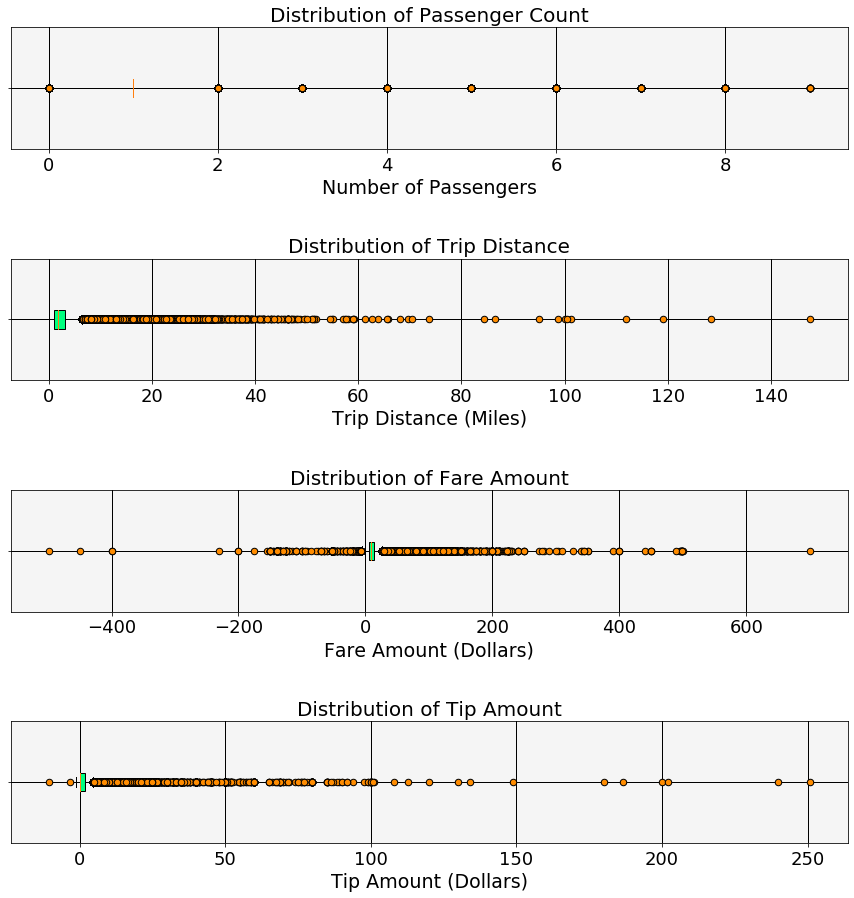

In [5]:
fig, ax = plt.subplots(4, 1, figsize=(15,15), gridspec_kw={'wspace':0.5, 'hspace':0.9})

params = ['passenger_count','trip_distance','fare_amount', 'tip_amount']
x_label = ['Number of Passengers', 'Trip Distance (Miles)', 'Fare Amount (Dollars)', 'Tip Amount (Dollars)']
title = ['Passenger Count','Trip Distance', 'Fare Amount', 'Tip Amount']
flierprops = dict(marker='o', markerfacecolor='darkorange', linewidth=0.1, markersize=6.5)

for j in range(len(params)):
    df_plot = df[params[j]]
 
    box = ax[j].boxplot(df_plot,flierprops=flierprops, vert=False, patch_artist=True)
    ax[j].set_title('Distribution of'+' '+title[j], fontsize=20)
    ax[j].set_xlabel(x_label[j], fontsize=19) 
    ax[j].set_yticklabels([])
    ax[j].tick_params(axis='x', labelsize=18)
    ax[j].grid(True, zorder=1, color='k', linestyle='-', linewidth=1)
    ax[j].set_axisbelow(True)
    plt.sca(ax[j])
    plt.gca().patch.set_facecolor('whitesmoke')
    ax[j].invert_yaxis()
    
    string = 'springgreen'
    colors = int(len(params))*string.split()
    for patch, color in zip(box['boxes'], colors):
        patch.set_facecolor(color)
plt.show()

## Drop missing records and filter by Location

• Prior to applying the mask and filtering the data, we are going to consider records which may contain inaccurate or missing data. The initial DataFrame contains 1,048,574 records.

• Upon the initial inspection of the Taxi Trips DataFrame, there were a few instances of records which contained illogical information across features.

• Data that contained no passenger count, trip distance or fare time were automatically dropped because it suggests these records are physically not possible. If any one of these features are missing it suggests the entire record is of unreliable quality.

• Passenger counts exceeding 7 were dropped. The largest full-size SUV is capable of 2 rows of 3 passenger seating and one seat for an additional passenger up front. 8 or more passengers would require a van which are not used by Green Taxis.  

• Finally, any fare amount less than zero was dropped due to unreliability. To interpolate the fare based on the tip and total amount would not be feasible nor reliable. 

•  Follwing the this pre-processing step, the data masks for pickups and dropoffs were applied to filter by location.

In [6]:
# Drop records that have missing values or unreliable data
df.drop(df[df['passenger_count'] == 0].index, inplace = True) # No Passenger Record
df.drop(df[df['passenger_count'] > 7].index, inplace = True) # Drop unrealistic passenger Records
df.drop(df[df['trip_distance'] == 0].index, inplace = True) # No Trip Distance Record
df.drop(df[df['fare_amount'] <= 0].index, inplace = True) # Fare is less than or eqal to zero
df.drop(df[df['tip_amount'] < 0].index, inplace = True) # Tip amount is less than zero
df.drop(df[df['time_delta'] == '00:00:00'].index, inplace = True) # No Fare time duration recorded

# Filtered pickup location DataFrames
Bronx_PU = df[Bronx_mask]
Brooklyn_PU = df[Brooklyn_mask]
Manhattan_PU = df[Manhattan_mask]
Queens_PU = df[Queens_mask]
Staten_PU = df[Staten_mask]
EWR_PU = df[EWR_mask]
Unknown_PU = df[Unknown_mask]

# Filtered pickup location DataFrames
Bronx_DO = df[Bronx_mask2]
Brooklyn_DO = df[Brooklyn_mask2]
Manhattan_DO = df[Manhattan_mask2]
Queens_DO = df[Queens_mask2]
Staten_DO = df[Staten_mask2]
EWR_DO = df[EWR_mask2]
Unknown_DO = df[Unknown_mask2]

df

C:\Users\John\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

C:\Users\John\Anaconda3\lib\site-packages\ipykernel_launcher.py:11: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

C:\Users\John\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

C:\Users\John\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

C:\Users\John\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

C:\Users\John\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

C:\Users\John\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: UserWarning:

Boolean Series key will be reindexed to ma

,VendorID,lpep_pickup_datetime,lpep_dropoff_datetime,store_and_fwd_flag,RatecodeID,PULocationID,DOLocationID,passenger_count,trip_distance,fare_amount,...,mta_tax,tip_amount,tolls_amount,ehail_fee,improvement_surcharge,total_amount,payment_type,trip_type,time_delta,day_of_week
0,2,2016-12-01 00:00:00,2016-12-01 00:06:00,N,1,92,192,1,1.29,6.5,...,0.5,0.00,0.0,NaN,0.3,7.80,2,1,00:06:00,3
1,2,2016-12-01 00:52:00,2016-12-01 00:54:00,N,1,92,171,1,0.64,4.0,...,0.5,1.06,0.0,NaN,0.3,6.36,1,1,00:02:00,3
2,2,2016-12-01 00:10:00,2016-12-01 00:14:00,N,1,75,238,2,0.89,5.5,...,0.5,1.70,0.0,NaN,0.3,8.50,1,1,00:04:00,3
3,2,2016-12-01 00:12:00,2016-12-01 00:15:00,N,1,166,151,1,0.66,4.5,...,0.5,1.74,0.0,NaN,0.3,7.54,1,1,00:03:00,3
4,2,2016-12-01 00:29:00,2016-12-01 00:39:00,N,1,166,42,1,2.15,9.5,...,0.5,2.16,0.0,NaN,0.3,12.96,1,1,00:10:00,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1048569,2,2016-12-26 22:13:00,2016-12-26 22:53:00,N,1,7,227,2,10.87,36.0,...,0.5,0.00,0.0,NaN,0.3,37.30,2,1,00:40:00,0
1048570,2,2016-12-26 22:16:00,2016-12-26 22:35:00,N,1,255,102,1,3.85,15.5,...,0.5,3.36,0.0,NaN,0.3,20.16,1,1,00:19:00,0
1048571,2,2016-12-26 22:15:00,2016-12-26 22:35:00,N,1,181,164,1,5.32,19.0,...,0.5,4.06,0.0,NaN,0.3,24.36,1,1,00:20:00,0
1048572,2,2016-12-26 22:32:00,2016-12-26 23:03:00,N,1,97,140,1,8.26,30.0,...,0.5,0.00,0.0,NaN,0.3,31.30,2,1,00:31:00,0


• After dropping 21,544 records, the resultant DataFrame now contains 1,027,030 data points for analysis.

• Despite the nominal change, exhibiting quality control on the data is good practice to ensure an accurate and thorough computation.

• By visualizing the distribution of important features related to common and realistic taxi trips, we can get a sense of how to screen for outliers within the data.

• Upon close inspection, a disparate gap presents itself between the 99th percentile of the data and the max values across the features of trip distance, fare amount and total fare amount.

• The goal will be to eliminate any extreme values that may adversely affect the distribution of the data.

In [7]:
df_stats = df[['trip_distance', 'fare_amount', 'total_amount']].describe(percentiles = [.25,.50,.75,.95,.99])
df_stats.round(2)

,trip_distance,fare_amount,total_amount
count,1027030.00,1027030.00,1027030.00
mean,2.67,11.68,14.13
std,2.81,9.01,10.46
min,0.01,0.01,0.01
25%,1.00,6.00,7.80
50%,1.72,9.00,10.80
75%,3.25,14.00,16.71
95%,7.90,28.00,33.30
99%,14.10,46.00,54.34
max,147.50,700.00,712.38


## Search for outliers for selected features across location

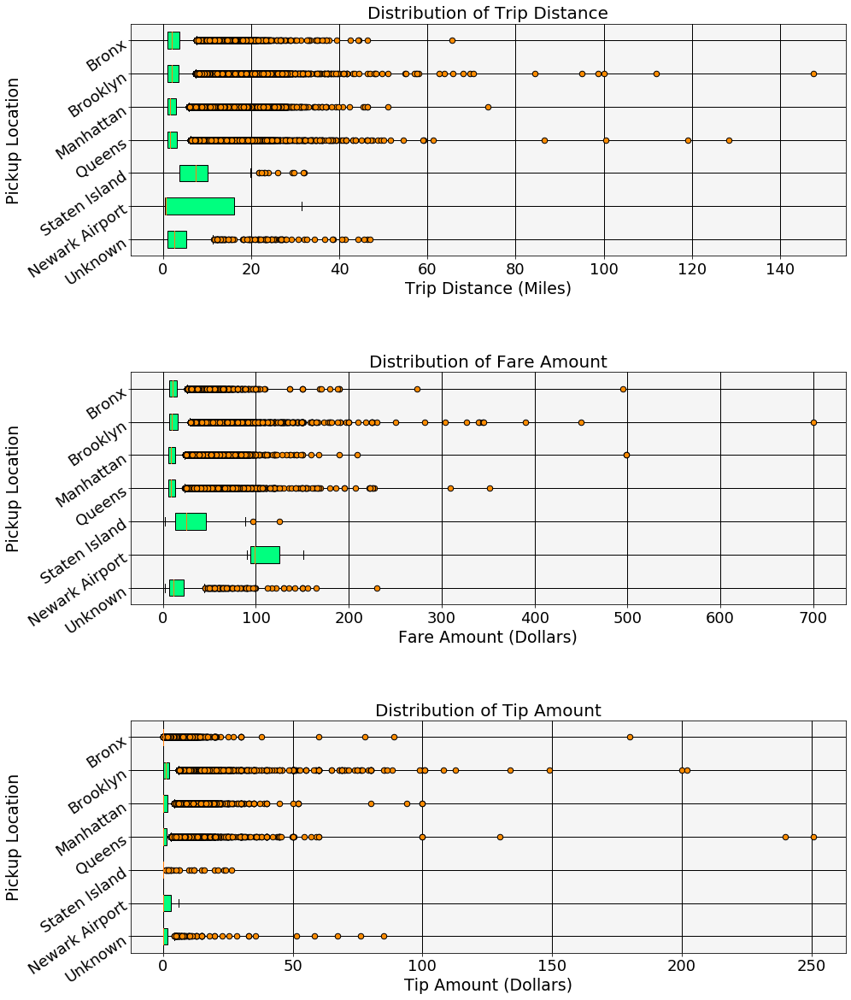

In [8]:
fig, ax = plt.subplots(3, 1, figsize=(15,20), gridspec_kw={'wspace':0.5, 'hspace':0.5})

appended_data = []
column_labels = ['Bronx', 'Brooklyn', 'Manhattan', 'Queens', 'Staten', 'EWR', 'Unknown']
labels_text = ['Bronx', 'Brooklyn', 'Manhattan', 'Queens', 'Staten Island', 'Newark Airport', 'Unknown']
params = ['trip_distance','fare_amount', 'tip_amount']
x_label = ['Trip Distance (Miles)', 'Fare Amount (Dollars)', 'Tip Amount (Dollars)']
title = ['Trip Distance', 'Fare Amount', 'Tip Amount']
flierprops = dict(marker='o', markerfacecolor='darkorange', linewidth=0.1, markersize=6.5)

for j in range(len(params)):
    for i in range(len(Location)):  
        appended_data.append(np.array(globals()[str(column_labels[i])+'_PU'][params[j]]))
 
    box = ax[j].boxplot(appended_data[(j*7):(j*7)+7],flierprops=flierprops, vert=False, patch_artist=True)
    ax[j].set_title('Distribution of'+' '+title[j], fontsize=20)
    ax[j].set_xlabel(x_label[j], fontsize=19)
    ax[j].set_ylabel('Pickup Location', fontsize=19)    
    ax[j].set_yticklabels(labels_text, fontsize='18', rotation=35, ha='right', rotation_mode='anchor')
    ax[j].tick_params(axis='x', labelsize=18)
    ax[j].grid(True, zorder=1, color='k', linestyle='-', linewidth=1)
    ax[j].set_axisbelow(True)
    plt.sca(ax[j])
    plt.gca().patch.set_facecolor('whitesmoke')
    ax[j].invert_yaxis()
    
    string = 'springgreen'
    colors = int(len(Location))*string.split()
    for patch, color in zip(box['boxes'], colors):
        patch.set_facecolor(color)
plt.show()

## Display the percentiles for each feature by location

In [9]:
x_cutoff = []
y_cutoff = []

for i in range(len(Location)):  
    print(str(column_labels[i]))
    df_stats = globals()[str(column_labels[i])+'_PU'][['trip_distance', 'fare_amount', 'tip_amount']].describe(percentiles = [.25,.50,.75,.95,.99])
    df_stats = df_stats.round(2)
    x_cutoff.append(df_stats['fare_amount'][8]) # 99th percentile fare amont
    y_cutoff.append(df_stats['trip_distance'][8]) # 99th percentile trip distance
    display(df_stats)

Bronx


,trip_distance,fare_amount,tip_amount
count,38339.00,38339.00,38339.00
mean,2.96,12.31,0.52
std,3.13,9.93,1.96
min,0.01,0.01,0.00
25%,1.10,7.00,0.00
50%,1.95,10.00,0.00
75%,3.67,14.50,0.00
95%,8.92,30.00,3.09
99%,15.75,51.50,8.00
max,65.53,495.00,180.00


Brooklyn


,trip_distance,fare_amount,tip_amount
count,365237.00,365237.00,365237.00
mean,2.86,12.50,1.54
std,2.89,9.69,2.43
min,0.01,0.01,0.00
25%,1.06,6.50,0.00
50%,1.93,9.50,1.00
75%,3.60,15.50,2.36
95%,8.21,30.00,5.26
99%,13.97,48.00,9.26
max,147.50,700.00,202.00


Manhattan


,trip_distance,fare_amount,tip_amount
count,322365.00,322365.00,322365.00
mean,2.50,11.07,1.10
std,2.75,8.52,1.92
min,0.01,0.05,0.00
25%,0.94,6.00,0.00
50%,1.57,8.50,0.00
75%,2.90,13.00,1.76
95%,7.60,27.00,4.66
99%,14.87,49.00,8.27
max,73.74,499.00,100.00


Queens


,trip_distance,fare_amount,tip_amount
count,300178.00,300178.00,300178.00
mean,2.57,11.21,0.84
std,2.69,8.32,1.89
min,0.01,0.01,0.00
25%,1.00,6.00,0.00
50%,1.67,8.50,0.00
75%,3.07,13.00,1.26
95%,7.76,27.00,4.00
99%,13.70,42.50,7.61
max,128.40,351.50,250.70


Staten


,trip_distance,fare_amount,tip_amount
count,111.00,111.00,111.00
mean,8.84,32.86,2.10
std,7.49,23.90,5.50
min,0.01,2.50,0.00
25%,3.80,13.00,0.00
50%,7.47,25.00,0.00
75%,10.23,46.25,0.00
95%,23.55,76.50,15.42
99%,31.69,96.15,24.04
max,32.10,125.00,26.28


EWR


,trip_distance,fare_amount,tip_amount
count,3.00,3.00,3.00
mean,10.72,113.50,2.00
std,17.94,33.22,3.46
min,0.07,90.00,0.00
25%,0.36,94.50,0.00
50%,0.66,99.00,0.00
75%,16.05,125.25,3.00
95%,28.36,146.25,5.40
99%,30.82,150.45,5.88
max,31.44,151.50,6.00


Unknown


,trip_distance,fare_amount,tip_amount
count,797.00,797.00,797.00
mean,5.05,20.81,1.92
std,7.20,25.37,6.44
min,0.01,2.50,0.00
25%,1.10,7.00,0.00
50%,2.50,11.00,0.00
75%,5.21,22.00,1.75
95%,22.24,72.70,7.53
99%,36.75,130.22,28.68
max,46.90,230.50,85.00


• Below are plots to visualize the data in terms of the features trip distance and fare amount across all locations. 

• We see that the further a passenger travels the higher the fare amount will be. The degree to which this relationship exists between the two features depends on the trip type, fare rate, number of passengers etc. 

• The focus is on all demand because a driver will not necessarily know what type of trip the passenger will be taking until the pickup has been made.

• Tips are not always guaranteed for a driver or may show inconsistencies because it is a subjective assessment based on the ride experience. Therefore, fare amount serves as a better feature over total fare amount when drawing a comparison to trip distance.  

• For all locations the same criteria has been adopted to screen for outliers:

~ Remove all trips that fall into the top 1% in terms of trip distance and fare amount. Note this varies by location.
   
• This condition is displayed graphically as a set of dotted red lines. Any dots not contained within the box created the lower left corner of the axis and the dotted red lines will be screened out.

• Trips that far exceed the city limits or yielded unreasonably high fares relative to trip distance have now been removed.

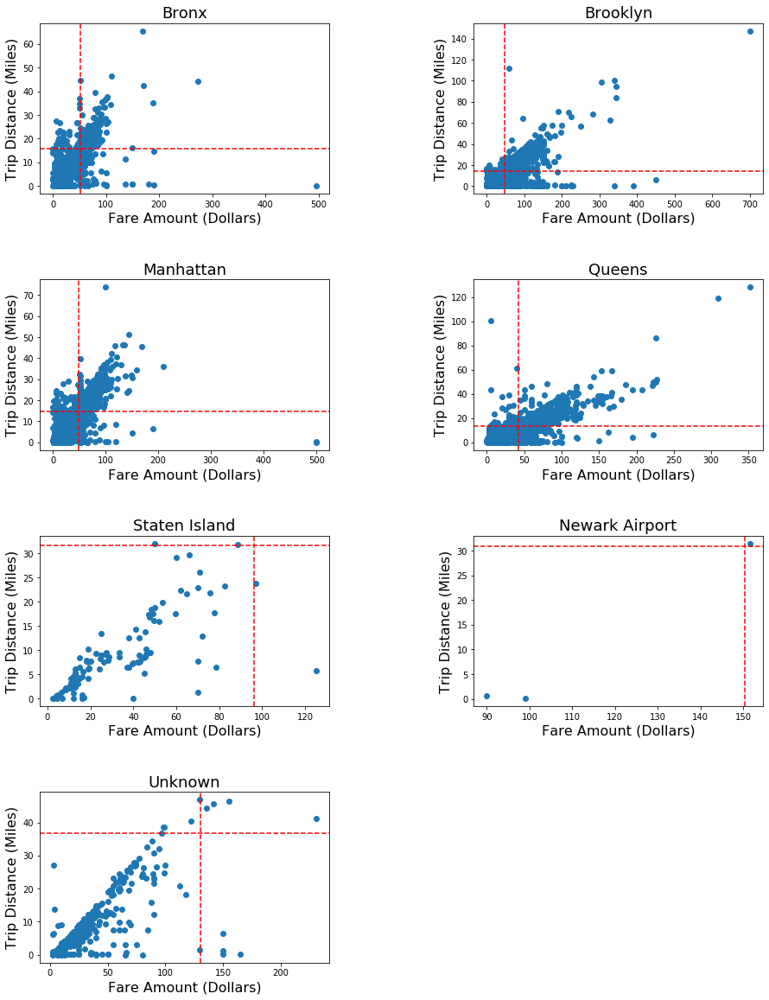

In [10]:
fig, ax = plt.subplots(4, 2, figsize=(15,20), gridspec_kw={'wspace':0.5, 'hspace':0.5})
k = [0,0,1,1,2,2,3,3]
column_labels = ['Bronx', 'Brooklyn', 'Manhattan', 'Queens', 'Staten', 'EWR', 'Unknown']
labels = ['Bronx', 'Brooklyn', 'Manhattan', 'Queens', 'Staten Island', 'Newark Airport', 'Unknown']

for i in range(len(Location)):
    ax[k[i],i % 2].scatter(globals()[str(column_labels[i])+'_PU']['fare_amount'],globals()[str(column_labels[i])+'_PU']['trip_distance'])
    ax[k[i],i % 2].set_title(labels[i], fontsize=18)
    ax[k[i],i % 2].set_xlabel('Fare Amount (Dollars)', fontsize='16')
    ax[k[i],i % 2].set_ylabel('Trip Distance (Miles)', fontsize='16')
    ax[k[i],i % 2].axvline(x=x_cutoff[i], color='r', linestyle='--')
    ax[k[i],i % 2].axhline(y=y_cutoff[i], color='r', linestyle='--')
fig.delaxes(ax[3][1])


# Apply the conditional drop to the original Taxi Trip DataFrame and update the filters

• Revisiting the concept of the DataFrame filters we will use the filtered pickup location DataFrames to establish the basis for data dictionaries.

• These dictionaries will link the relationship between pickup and dropoff locations utilizing another DataFrame mask. Please see the explanation and code in the next section for a better understanding. 

In [11]:
df['pickup_borough'] = [None]*len(df) 

# Create a column for borough column location labels 
# Drop the top 1% of trip distance and fare amount by location
for i in range(len(Location)):  
    df['pickup_borough'][globals()[str(column_labels[i])+'_mask']] = column_labels[i]
    df.drop(df[(df['trip_distance'] > y_cutoff[i]) & (df['pickup_borough'] == column_labels[i])].index, inplace = True)  
    df.drop(df[(df['fare_amount'] > x_cutoff[i]) & (df['pickup_borough'] == column_labels[i])].index, inplace = True) 

# Filtered pickup location DataFrames
Bronx_PU = df[Bronx_mask]
Brooklyn_PU = df[Brooklyn_mask]
Manhattan_PU = df[Manhattan_mask]
Queens_PU = df[Queens_mask]
Staten_PU = df[Staten_mask]
EWR_PU = df[EWR_mask]
Unknown_PU = df[Unknown_mask]

# Filtered pickup location DataFrames
Bronx_DO = df[Bronx_mask2]
Brooklyn_DO = df[Brooklyn_mask2]
Manhattan_DO = df[Manhattan_mask2]
Queens_DO = df[Queens_mask2]
Staten_DO = df[Staten_mask2]
EWR_DO = df[EWR_mask2]
Unknown_DO = df[Unknown_mask2]

df

C:\Users\John\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\John\Anaconda3\lib\site-packages\ipykernel_launcher.py:11: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

C:\Users\John\Anaconda3\lib\site-packages\ipykernel_launcher.py:12: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

C:\Users\John\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

C:\Users\John\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

C:\Users\John\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: UserWarning:

Boolean Series key will be reindexe

,VendorID,lpep_pickup_datetime,lpep_dropoff_datetime,store_and_fwd_flag,RatecodeID,PULocationID,DOLocationID,passenger_count,trip_distance,fare_amount,...,tip_amount,tolls_amount,ehail_fee,improvement_surcharge,total_amount,payment_type,trip_type,time_delta,day_of_week,pickup_borough
0,2,2016-12-01 00:00:00,2016-12-01 00:06:00,N,1,92,192,1,1.29,6.5,...,0.00,0.0,NaN,0.3,7.80,2,1,00:06:00,3,Queens
1,2,2016-12-01 00:52:00,2016-12-01 00:54:00,N,1,92,171,1,0.64,4.0,...,1.06,0.0,NaN,0.3,6.36,1,1,00:02:00,3,Queens
2,2,2016-12-01 00:10:00,2016-12-01 00:14:00,N,1,75,238,2,0.89,5.5,...,1.70,0.0,NaN,0.3,8.50,1,1,00:04:00,3,Manhattan
3,2,2016-12-01 00:12:00,2016-12-01 00:15:00,N,1,166,151,1,0.66,4.5,...,1.74,0.0,NaN,0.3,7.54,1,1,00:03:00,3,Manhattan
4,2,2016-12-01 00:29:00,2016-12-01 00:39:00,N,1,166,42,1,2.15,9.5,...,2.16,0.0,NaN,0.3,12.96,1,1,00:10:00,3,Manhattan
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1048569,2,2016-12-26 22:13:00,2016-12-26 22:53:00,N,1,7,227,2,10.87,36.0,...,0.00,0.0,NaN,0.3,37.30,2,1,00:40:00,0,Queens
1048570,2,2016-12-26 22:16:00,2016-12-26 22:35:00,N,1,255,102,1,3.85,15.5,...,3.36,0.0,NaN,0.3,20.16,1,1,00:19:00,0,Brooklyn
1048571,2,2016-12-26 22:15:00,2016-12-26 22:35:00,N,1,181,164,1,5.32,19.0,...,4.06,0.0,NaN,0.3,24.36,1,1,00:20:00,0,Brooklyn
1048572,2,2016-12-26 22:32:00,2016-12-26 23:03:00,N,1,97,140,1,8.26,30.0,...,0.00,0.0,NaN,0.3,31.30,2,1,00:31:00,0,Brooklyn


• Revisiting the Taxi Trip DataFrame and distribution of important features, we see an additional 12796 data points have been dropped.

• While this has not changed the mean values in any significant way, the gap between the 99th percentiles and max values are much more reasonable.

• Despite the lack of extreme change within the dataset, each location is now being viewed from the same lens and any uncertainty of outliers has been removed/disproven.

In [12]:
df_stats = df[['trip_distance', 'fare_amount', 'total_amount']].describe(percentiles = [.25,.50,.75,.95,.99])
df_stats.round(2)

,trip_distance,fare_amount,total_amount
count,1014234.00,1014234.00,1014234.00
mean,2.49,11.11,13.48
std,2.23,7.12,8.30
min,0.01,0.01,0.01
25%,1.00,6.00,7.80
50%,1.70,9.00,10.80
75%,3.17,14.00,16.30
95%,7.32,26.00,30.96
99%,10.86,36.50,43.30
max,36.68,130.00,278.00


# Restructure the data into dictionaries so that it is easily accessible in the frame of pickup and dropoff locations

• A series of keys has been defined to access the location of a taxi ride

• Considering that there are 7 possible locations for Green Taxis to conduct business, that yields 49 possible pickup-dropoff locations that can take place.

• Starting with the frame of pickup locations, we will separate out the elements of the dropoffs by checking whether each element in the DataFrame is contained in values. This process is the same as when the masks were created but this time we are looking at the dropoff locations within the context of the pickup locations.

• This process is iterative in the sense that all dropoff locations will be indexed through according to the keys list. The loop will be performed for each dictionary which checks for the condition within each of the filtered pickup location DataFrames.

• See the example below for more context

In [13]:
keys = ['Bronx', 'Brooklyn', 'Manhattan', 'Queens', 'Staten', 'EWR', 'Unknown']

Bronx = {}
Brooklyn = {}
Manhattan = {}
Queens = {}
Staten = {}
EWR = {}
Unknown = {}

counts = []
percents = []
agg_counts = [None]*len(Location)

for i in range(len(Location)):
    
    Bronx[keys[i]] = Bronx_PU[Bronx_PU['DOLocationID'].isin(Location[i])]
    Brooklyn[keys[i]] = Brooklyn_PU[Brooklyn_PU['DOLocationID'].isin(Location[i])]
    Manhattan[keys[i]] = Manhattan_PU[Manhattan_PU['DOLocationID'].isin(Location[i])]
    Queens[keys[i]] = Queens_PU[Queens_PU['DOLocationID'].isin(Location[i])]
    Staten[keys[i]] = Staten_PU[Staten_PU['DOLocationID'].isin(Location[i])]
    EWR[keys[i]] = EWR_PU[EWR_PU['DOLocationID'].isin(Location[i])]
    Unknown[keys[i]] = Unknown_PU[Unknown_PU['DOLocationID'].isin(Location[i])]

# Store the data from the dictionaries for future computation and plotting    
for i in range(len(Location)):
    for j in range(len(Location)):
        counts.append(len(globals()[keys[i]][keys[j]]))
    agg_counts[i] = counts[(i*7):(i*7)+7] # Nested list of the dropoff counts to each location w.r.t. the pickup location
    percents.append(np.true_divide(agg_counts[i], sum(agg_counts[i]))*100)

# Creating a dictionary example:

• Utilizing the pickup location DataFrame for The Bronx, every instance of a pickup in that Borough is detailed below. This establishes the data in the 'frame' of pickups with respect to The Bronx.

• By creating a mask for this DataFrame we will check the Dropoff Loction ID to see where each pickup in The Bronx leads to.

In [14]:
Bronx_PU

,VendorID,lpep_pickup_datetime,lpep_dropoff_datetime,store_and_fwd_flag,RatecodeID,PULocationID,DOLocationID,passenger_count,trip_distance,fare_amount,...,tip_amount,tolls_amount,ehail_fee,improvement_surcharge,total_amount,payment_type,trip_type,time_delta,day_of_week,pickup_borough
55,2,2016-12-01 00:05:00,2016-12-01 00:10:00,N,1,168,159,1,1.06,6.0,...,1.46,0.0,NaN,0.3,8.76,1,1,00:05:00,3,Bronx
71,2,2016-12-01 00:37:00,2016-12-01 00:41:00,N,1,247,119,2,0.66,4.5,...,1.16,0.0,NaN,0.3,6.96,1,1,00:04:00,3,Bronx
75,2,2016-12-01 00:18:00,2016-12-01 00:29:00,N,1,159,169,5,2.39,10.0,...,0.00,0.0,NaN,0.3,11.30,2,1,00:11:00,3,Bronx
116,2,2016-12-01 00:38:00,2016-12-01 00:45:00,N,1,250,213,1,1.27,6.5,...,0.00,0.0,NaN,0.3,7.80,1,1,00:07:00,3,Bronx
124,2,2016-12-01 00:25:00,2016-12-01 00:27:00,N,1,78,248,1,0.43,4.0,...,2.00,0.0,NaN,0.3,7.30,1,1,00:02:00,3,Bronx
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1048289,2,2016-12-26 22:10:00,2016-12-26 22:34:00,N,1,242,166,1,10.52,30.5,...,0.00,0.0,NaN,0.3,31.80,2,1,00:24:00,0,Bronx
1048318,2,2016-12-26 22:11:00,2016-12-26 22:24:00,N,5,167,20,1,2.46,8.0,...,0.00,0.0,NaN,0.0,8.00,2,2,00:13:00,0,Bronx
1048319,2,2016-12-26 22:28:00,2016-12-26 22:49:00,N,5,20,212,1,4.48,10.0,...,0.00,0.0,NaN,0.0,10.00,2,2,00:21:00,0,Bronx
1048358,2,2016-12-26 22:22:00,2016-12-26 22:28:00,N,5,167,159,1,1.08,8.0,...,0.00,0.0,NaN,0.0,8.00,2,2,00:06:00,0,Bronx


•  This process is iterative so the key for each dictionary details all of the rides that led to that particular location.

• The output from the example below explains the context of all of the pickups in The Bronx that led to Brooklyn. 

• By changing the key to this particular dictionary, the frame of Bronx pickup location is maintained while changing the relative dropoff location.

In [15]:
Bronx['Queens']

,VendorID,lpep_pickup_datetime,lpep_dropoff_datetime,store_and_fwd_flag,RatecodeID,PULocationID,DOLocationID,passenger_count,trip_distance,fare_amount,...,tip_amount,tolls_amount,ehail_fee,improvement_surcharge,total_amount,payment_type,trip_type,time_delta,day_of_week,pickup_borough
935,1,2016-12-01 00:23:00,2016-12-01 00:46:00,N,1,247,83,1,9.00,27.5,...,0.0,5.54,NaN,0.3,34.34,2,1,00:23:00,3,Bronx
2476,1,2016-12-01 04:08:00,2016-12-01 04:22:00,N,5,182,138,2,8.70,45.0,...,0.0,0.00,NaN,0.0,45.00,2,2,00:14:00,3,Bronx
2590,2,2016-12-01 05:05:00,2016-12-01 05:24:00,N,1,167,138,1,7.82,24.5,...,0.0,5.54,NaN,0.3,31.34,2,1,00:19:00,3,Bronx
5528,2,2016-12-01 08:49:00,2016-12-02 08:42:00,N,5,168,138,2,6.61,40.0,...,0.0,5.54,NaN,0.0,45.54,1,2,23:53:00,3,Bronx
6145,2,2016-12-01 08:43:00,2016-12-01 08:56:00,N,1,182,53,1,6.45,19.5,...,0.0,5.54,NaN,0.3,25.84,1,1,00:13:00,3,Bronx
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1034740,2,2016-12-26 13:27:00,2016-12-26 13:47:00,N,1,168,138,1,7.60,23.0,...,0.0,5.54,NaN,0.3,29.34,2,1,00:20:00,0,Bronx
1041830,1,2016-12-26 17:09:00,2016-12-26 17:41:00,N,1,159,193,1,9.80,31.0,...,11.2,5.54,NaN,0.3,48.54,1,1,00:32:00,0,Bronx
1043386,1,2016-12-26 18:08:00,2016-12-26 18:40:00,N,1,69,82,1,8.70,30.0,...,0.0,5.54,NaN,0.3,36.34,2,1,00:32:00,0,Bronx
1043545,2,2016-12-26 19:28:00,2016-12-26 19:44:00,N,1,168,7,1,4.12,16.0,...,0.0,5.54,NaN,0.3,22.34,2,1,00:16:00,0,Bronx


# Create a Table that summarizes all 49 Pickup-Dropoff Combinations

In [16]:
data_pickup = [len(Bronx_PU),len(Brooklyn_PU),len(Manhattan_PU),len(Queens_PU),len(Staten_PU),len(EWR_PU),len(Unknown_PU)]
labels = ['Bronx', 'Brooklyn', 'Manhattan', 'Queens', 'Staten Island', 'Newark Airport', 'Unknown', 'Total']
total_df = pd.DataFrame(data_pickup)
counts_df = pd.DataFrame(agg_counts,)
a = pd.concat([counts_df,total_df],axis=1)
b = pd.DataFrame(a.sum(axis=0))
taxi_table = pd.concat([a,b.T])
taxi_table.columns = labels
taxi_table.index = labels
print('Pickup Location vs. Dropoff Location')
taxi_table

Pickup Location vs. Dropoff Location


,Bronx,Brooklyn,Manhattan,Queens,Staten Island,Newark Airport,Unknown,Total
Bronx,28265,50,8661,455,0,0,405,37836
Brooklyn,162,291636,51864,16453,85,1,196,360397
Manhattan,25375,1379,285237,6288,0,0,530,318809
Queens,915,9410,17678,267855,0,0,440,296298
Staten Island,0,36,1,2,65,0,3,107
Newark Airport,0,0,0,0,0,2,0,2
Unknown,71,167,171,160,3,5,208,785
Total,54788,302678,363612,291213,153,8,1782,1014234


This table forms the basis of summarizing every pickup and dropoff instance over the month of December. The bullet points below provide a synopsis of the events.

• The table above contains a column and row of labels which refer to the pickup and dropoff locations respectively.

• Taking the intersection of 'Queens' on the left hand column and 'Manhattan' from the top row, translates to 17,678 pickups in Queens that were dropped off to Manhattan.

• A majority of the demand is confined to the upper left side of the table. Consisting of The Bronx, Brooklyn, Manhattan and Queens. The remaining 3 locations wane in demand considerably in terms of pickups and dropoffs.

• Going along down the diagonal of the table we see that the majority of trips that start in a Borough typically end in that Borough - more on that later.

• The 'Total' Column at the right hand of the table is a summary of all of the pickups in each Borough while the bottom row labeled 'Total' is a summary of all of the dropoffs in each borough.

• The intersection of the row and column totals yields the entire amount of taxi rides for the month of December.

## Now that the dataset has been pre-process and structured, the next phase of this notebook will consist of a series of visual statistics. Each figure will have a header explaining what it is followed by a set of bullet points explaining the significance of the findings. Conclusions will be drawn on the data based on the observations where necessary. 

# Pickup Location Bar Plot

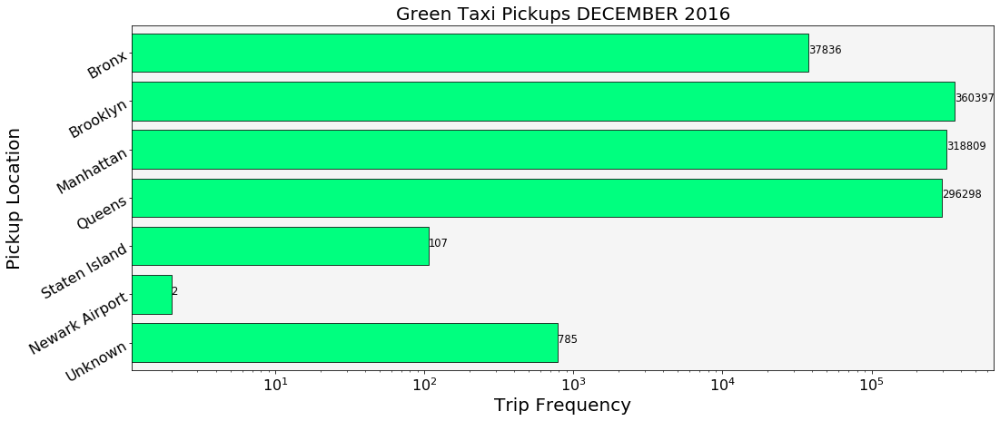

In [17]:
fig, ax = plt.subplots(figsize=(17,7))
data = taxi_table['Total'][0:7]
labels = ['Bronx', 'Brooklyn', 'Manhattan', 'Queens', 'Staten Island', 'Newark Airport', 'Unknown']

ax.barh(labels,data,color='springgreen',edgecolor='k', linewidth='0.75',)
ax.set_title('Green Taxi Pickups DECEMBER 2016', fontsize='20')
ax.set_xlabel('Trip Frequency', fontsize='20')
ax.set_ylabel('Pickup Location', fontsize='20')
plt.gca().patch.set_facecolor('whitesmoke')
ax.margins(y=0.025)
ax.invert_yaxis()

plt.xticks(fontsize=16) # x-axis formatting
plt.yticks(rotation=30, fontsize=16, ha='right', rotation_mode='anchor') # y-axis formatting

for index, value in enumerate(data):
    plt.text(value, index, str(value), fontsize=11.5)

ax.set_xscale('log')
plt.show()

• The resultant bar graph is an effective way to summarize the demand across location.

• The Boroughs of Brooklyn, Manhattan and Queens maintain approximately an equal share of the demand.

• The Bronx contains approximately 1/10th the amount of pickups than any of the top three Boroughs. 

• Pickups outside of the city, Staten Island and Newark Airport are nominal compared to all of the pickups for the month.

• Note the Trip Frequency presents the demand on a Logarithmic scale in order to better visualize the totals. The bars are not on a standard scale.

# Pickup Location Pie Chart

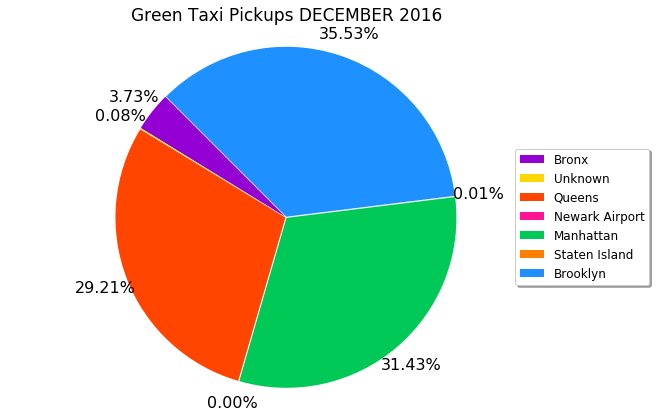

In [18]:
# Pie Chart Properties
fig, ax = plt.subplots(figsize=(10,7))
explode = (0.004,0.004,0.004,0.004,0.004,0.004,0.004)

labels = ['Bronx','Unknown','Queens','Newark Airport','Manhattan','Staten Island','Brooklyn']
data = [len(Bronx_PU),len(Unknown_PU),len(Queens_PU),len(EWR_PU),len(Manhattan_PU),len(Staten_PU),len(Brooklyn_PU)]

colors = ['#9400D3','gold','#FF4500','#FF1493','#00C957','#FF8000','#1E90FF']
ax.pie(data, explode=explode, colors=colors, textprops={'fontsize': 16}, autopct='%1.2f%%', pctdistance=1.135, startangle=135)

# Label and format plot   
ax.set_title('Green Taxi Pickups DECEMBER 2016', fontsize='17')
#ax.set_xlabel('Total Call Volume:' + ' ' + str(sum(call_volume)), fontsize='20')
ax.legend(labels, loc="center left", bbox_to_anchor=(0.9, 0, 1.1, 1), prop={'size': 12}, shadow=True)
ax.axis('equal')  # Make shape of pie stay a circle
plt.show()

• The pie chart brings into context the order of magnitude of demand for each Borough.

• There is approximately an equal share of pickups across Brooklyn, Manhattan and Queens as confirmed by the table.

• These three locations collectively make up over 95% of the demand. Brooklyn has the most pickups followed by Manhattan then Queens.

• The Bronx in this frame is still relevant to pickup demand unlike the pickups in Staten Island and locations outside of NYC.

# Dropoff Location Bar Chart

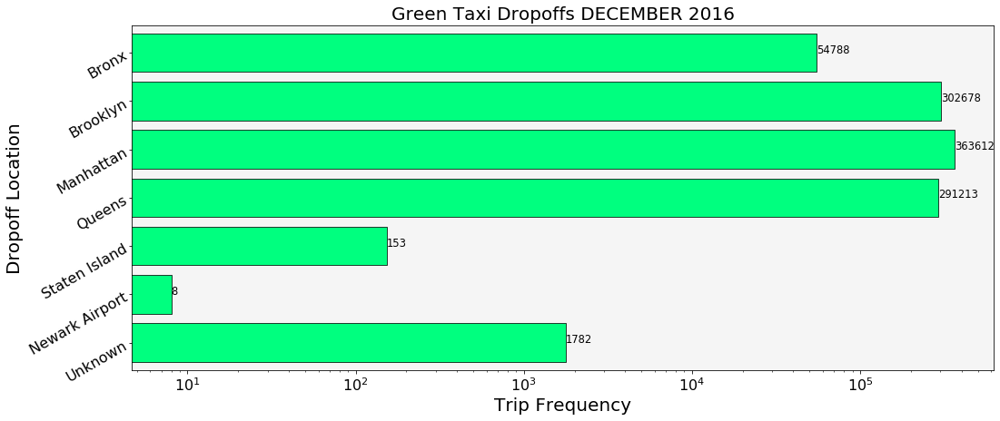

In [19]:
fig, ax = plt.subplots(figsize=(17,7))
data = taxi_table.iloc[7][0:7]
labels = ['Bronx', 'Brooklyn', 'Manhattan', 'Queens', 'Staten Island', 'Newark Airport', 'Unknown']

ax.barh(labels,data,color='springgreen',edgecolor='k', linewidth='0.75',)
ax.set_title('Green Taxi Dropoffs DECEMBER 2016', fontsize='20')
ax.set_xlabel('Trip Frequency', fontsize='20')
ax.set_ylabel('Dropoff Location', fontsize='20')
plt.gca().patch.set_facecolor('whitesmoke')
ax.margins(y=0.025)
ax.invert_yaxis()

plt.xticks(fontsize=16) # x-axis formatting
plt.yticks(rotation=30, fontsize=16, ha='right', rotation_mode='anchor') # y-axis formatting

for index, value in enumerate(data):
    plt.text(value, index, str(value), fontsize=11.5)

ax.set_xscale('log')
plt.show()

• The dropoffs bar chart was constructed in an identical fashion to the pickups bar chart. A visual representation of the dropoffs has been obtained.

• Relative to the pickup totals, we see that the number of dropoffs substantially increased for Staten Island and locations outside of NYC.

• Manhattan has the most dropoffs followed by Brooklyn and then Queens. The dropoff totals haven't changed much from the pickup totals. Brooklyn and Manhattan trade places for first and second however.

• The Bronx sees approximately 17,000 more dropoffs than pickups.

# Dropoff Location Pie Chart 

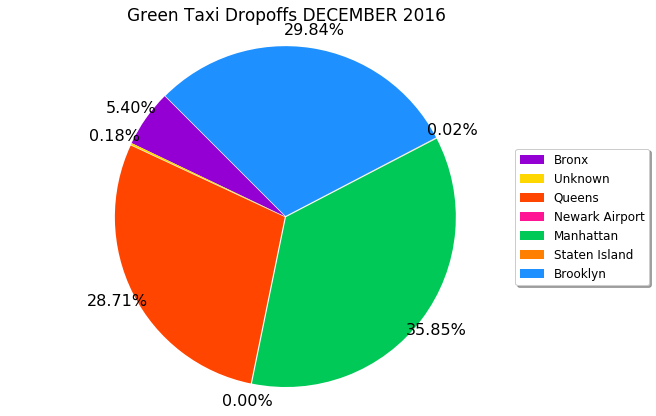

In [20]:
# Pie Chart Properties
fig, ax = plt.subplots(figsize=(10,7), gridspec_kw={'wspace':0.5, 'hspace':0.5})
explode = (0.004,0.004,0.004,0.004,0.004,0.004,0.004)

labels = ['Bronx','Unknown','Queens','Newark Airport','Manhattan','Staten Island','Brooklyn']
data = [len(Bronx_DO),len(Unknown_DO),len(Queens_DO),len(EWR_DO),len(Manhattan_DO),len(Staten_DO),len(Brooklyn_DO)]

colors = ['#9400D3','gold','#FF4500','#FF1493','#00C957','#FF8000','#1E90FF']
ax.pie(data, explode=explode, colors=colors, textprops={'fontsize': 16}, autopct='%1.2f%%', pctdistance=1.105, startangle=135)

# Label and format plot   
ax.set_title('Green Taxi Dropoffs DECEMBER 2016', fontsize='17')
#ax.set_xlabel('Total Call Volume:' + ' ' + str(sum(call_volume)), fontsize='20')
ax.legend(labels, loc="center left", bbox_to_anchor=(0.9, 0, 1.1, 1), prop={'size': 12}, shadow=True)
ax.axis('equal')  # Make shape of pie stay a circle
plt.show()

• The relative percentages of dropoffs compared to all ride activity across locations bears resemblance to the pickups percentages.

• Notably there is a slight increase in rides going outside of the city which follows suit to their purpose since Green Taxis are 'Boro Taxis' and make their pickups inside of the city not outside of it.

• A quick back of the envelope calculation confirms demand follows the population in relative proportions for most of the Boroughs.

According to the United States Census Bureau (2018) the estimated population of each Borough was:
Bronx: 1.43M (17%), Brooklyn: 2.58M (30.7%), Manhattan: 1.63M (19.4%), Queens: 2.28M (27%), Staten Island: 476k (0.06%), Total: 8,396,000

The disparity for Manhattan most likely exists due to people commuting into Manhattan by taxi from other locations. Residents in Manhattan are also less likely to own vehicles due to population density and as a result rely on taxis as a transportation alternative to leave the city and travel to other Boroughs (unlike Yellow Taxis). 

# Dropoff Location Breakdown with Respect to Pickup Location

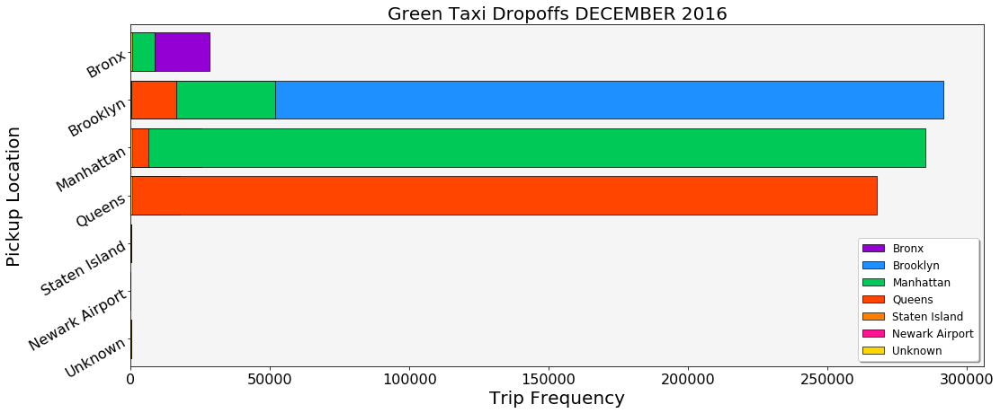

In [21]:
fig, ax = plt.subplots(figsize=(17,7))
labels = ['Bronx', 'Brooklyn', 'Manhattan', 'Queens', 'Staten Island', 'Newark Airport', 'Unknown']
colors = ['#9400D3','#1E90FF','#00C957','#FF4500','#FF8000','#FF1493','gold']
       
output = np.transpose(agg_counts) 


for i in range(len(Location)):
    data = output[i]  
    ax.barh(labels,data,color=colors[i],edgecolor='k', linewidth='0.7',label=labels[i])

ax.set_title('Green Taxi Dropoffs DECEMBER 2016', fontsize='20')
ax.set_xlabel('Trip Frequency', fontsize='20')
ax.set_ylabel('Pickup Location', fontsize='20')
plt.gca().patch.set_facecolor('whitesmoke')
ax.margins(y=0.025)
ax.invert_yaxis()

plt.xticks(fontsize=16) # x-axis formatting
plt.yticks(rotation=30, fontsize=16, ha='right', rotation_mode='anchor') # y-axis formatting
ax.legend(labels, loc="lower right", prop={'size': 12}, shadow=True)


plt.show()

• Above is a visual representation which breaks down the dropoff totals with respect to the pickup locations. The color coding yields perspective on how many trips remain in the location where the trip started.

• Interborough Green Taxi travel is highly prominent in the four Boroughs with the most demand.

• In this particular bar chart the Log scale has been removed in order to reflect the true order of magnitude of demand across locations in another way.

• Once again majority of the Green Taxi activity occurs within the three most populous Boroughs of NYC.

# Green Taxi Dropoff Pie Charts with Respect to Pickup Location 

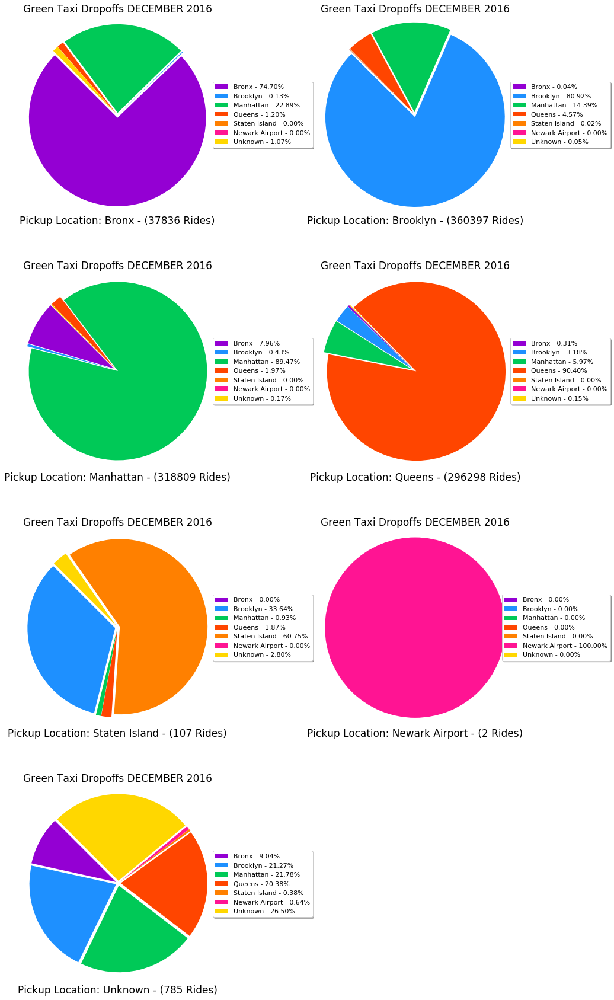

In [22]:
# Pie Chart Properties
fig, ax = plt.subplots(4, 2, figsize=(15,30), gridspec_kw={'wspace':0.5, 'hspace':0.3})
explode = (0.07,0.07,0.07,0.07,0.07,0.07,0.07)

labels = ['Bronx', 'Brooklyn', 'Manhattan', 'Queens', 'Staten Island', 'Newark Airport', 'Unknown']
colors = ['#9400D3','#1E90FF','#00C957','#FF4500','#FF8000','#FF1493','gold']
k = [0,0,1,1,2,2,3,3]

for i in range(len(Location)):
    # Plot a Pie Chart for all dropoffs based on pickup location
    ax[k[i],i % 2].pie(agg_counts[i], radius = 2.5, explode=explode, colors=colors, startangle=135)

    # Label and format plot   
    ax[k[i],i % 2].set_title('Green Taxi Dropoffs DECEMBER 2016', fontsize='17')
    ax[k[i],i % 2].set_xlabel('Pickup Location:' + ' ' + labels[i]+' '+'-'+' '+'('+str(data_pickup[i])+' '+'Rides'+')', 
                             fontsize='17')
    ax[k[i],i % 2].legend([m +' '+'-'+' '+str("{:0.2f}".format(n))+'%' for m,n in zip(labels, percents[i])], 
                         loc="center right", bbox_to_anchor=(0.4, 0, 1.1, 1), prop={'size': 11}, shadow=True)
    ax[k[i],i % 2].axis('equal')  # Make shape of pie stay a circle
fig.delaxes(ax[3][1])
plt.show()

• The pie charts above summarize the percentages of dropoffs relative to each pickup location. The two earlier pie charts break down pickups and dropoffs separately across the entire city. These charts are a way to hybridize these aspects into one.

• Interborough travel is the highest for Queens, Manhattan, Brooklyn and The Bronx at 90%, 89%, 81% and 75% respectively.
 
• Travel to neighboring Boroughs based on pickup location is also influenced by geography. For example, the most Manhattan pickups that end up in another Borough occur in The Bronx. Considering the pickup restrictions in Manhattan, limit operation to northern Manhattan the closest accessible Borough is The Bronx. Among the 21 bridges that connect to Manhattan, 13 of them connect to The Bronx and 5 of those are toll free. 

• The most common destination from Brooklyn and Queens other than interborough travel would be Manhattan. This makes sense due to work travel, tourism and weekend leisure.

• The remaining locations are not as significant but logically the most common destination from Staten Island would be Brooklyn based on geography.

# Histograms Quantifying Various Features

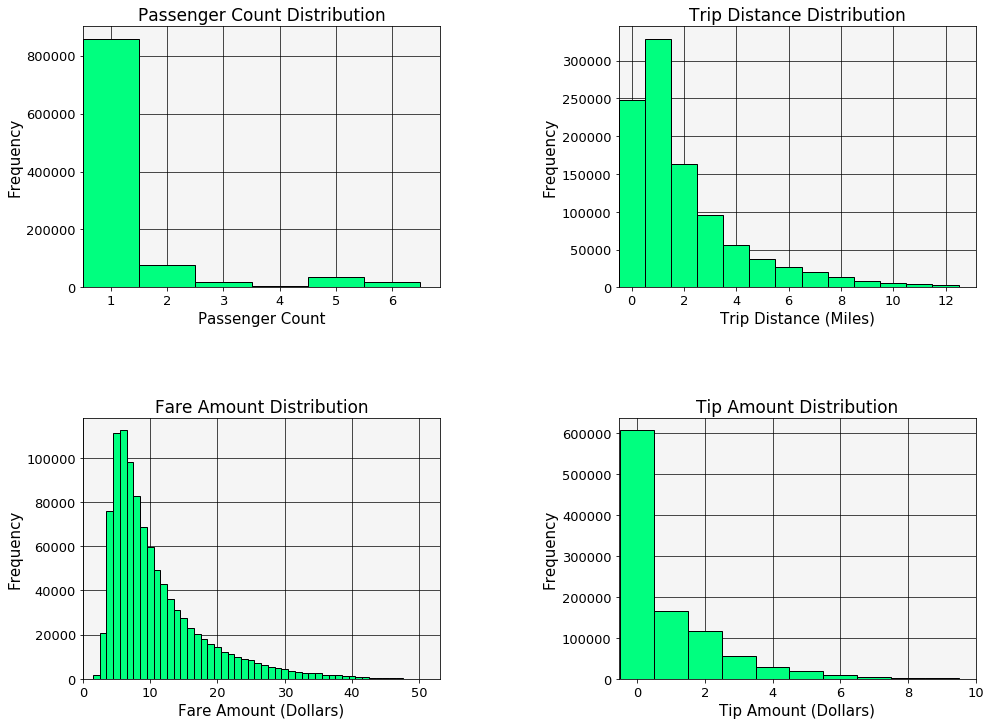

In [23]:
fig, ax = plt.subplots(2, 2, figsize=(16,12), gridspec_kw={'wspace':0.5, 'hspace':0.5})

params = ['passenger_count','trip_distance','fare_amount','tip_amount']
labels = ['Passenger Count','Trip Distance (Miles)','Fare Amount (Dollars)','Tip Amount (Dollars)']
titles = ['Passenger Count','Trip Distance','Fare Amount','Tip Amount']
bins = [8,14,52,11]
k = [0,0,1,1]
left_lim = [0.5,-0.5,0,-0.55]

for i in range(len(params)):
    ax[k[i],i % 2].hist(x=df[params[i]], bins=range(bins[i]),color='springgreen', edgecolor='black', 
             alpha=1, rwidth=1, label='Unmet Demand', align='left') 
    
    ax[k[i],i % 2].set_title(titles[i]+' '+'Distribution',fontsize=17)
    ax[k[i],i % 2].set_xlabel(labels[i],fontsize=15)
    ax[k[i],i % 2].set_ylabel('Frequency',fontsize=15)
    ax[k[i],i % 2].tick_params(axis='x', labelsize=13)
    ax[k[i],i % 2].tick_params(axis='y', labelsize=13)
    
    ax[k[i],i % 2].grid(True, zorder=1, color='k', linestyle='-', linewidth=0.7)
    ax[k[i],i % 2].set_axisbelow(True)
    ax[k[i],i % 2].set_xlim(left=left_lim[i])
    plt.sca(ax[k[i],i % 2])
    plt.gca().patch.set_facecolor('whitesmoke')
plt.show() 

• Here we observe characteristics of four features: Passenger Count, Trip Distance, Fare Amount and Tip Amont.

• The resultant histograms provide a clear depiction of the distribution of these features across all Green Taxi trips across the city.

• Single passenger rides make up approximately 80% of all Green Taxi Rides.

• Over 80% of the taxi trips are 3 miles in distance or less.

• Approximately 50% of the fares cost 10 dollars or less.

• Approximately 60% of riders provided no tip at all (About 1% provided a tip less than 1 dollar).

# Box Plot of Trip Distance and Fare Amount across all Locations

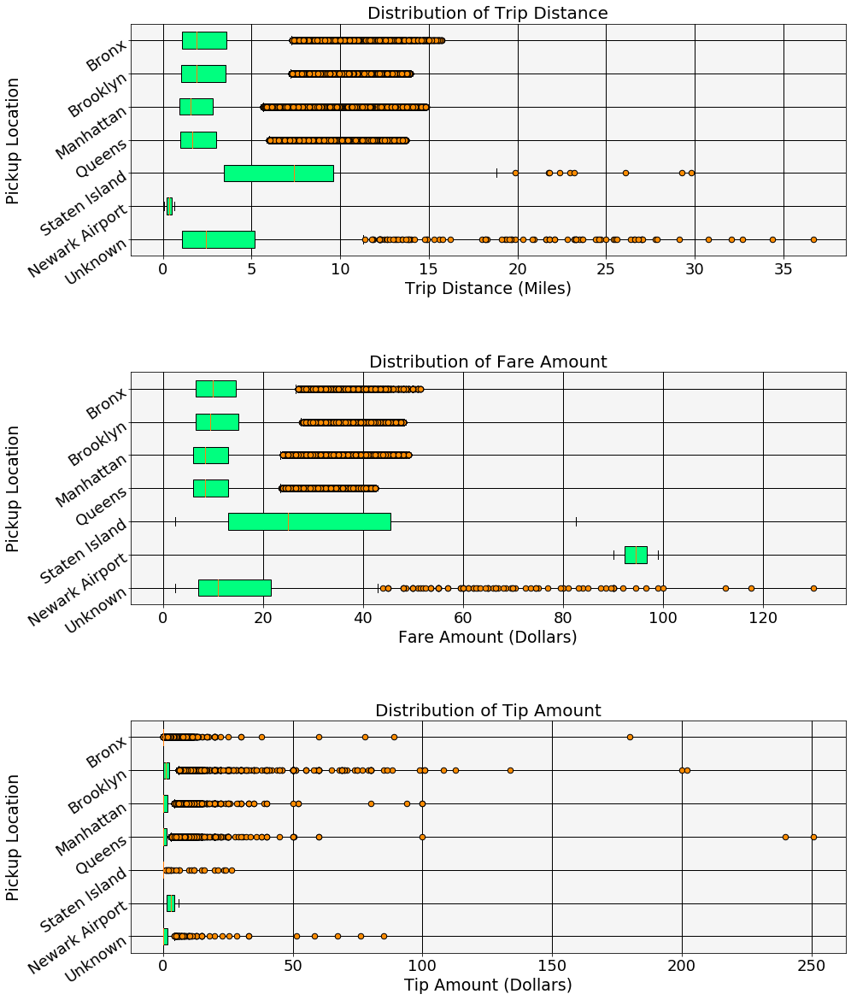

In [24]:
fig, ax = plt.subplots(3, 1, figsize=(15,20), gridspec_kw={'wspace':0.5, 'hspace':0.5})

appended_data = []
column_labels = ['Bronx', 'Brooklyn', 'Manhattan', 'Queens', 'Staten', 'EWR', 'Unknown']
labels_text = ['Bronx', 'Brooklyn', 'Manhattan', 'Queens', 'Staten Island', 'Newark Airport', 'Unknown']
params = ['trip_distance','fare_amount', 'tip_amount']
x_label = ['Trip Distance (Miles)', 'Fare Amount (Dollars)', 'Tip Amount (Dollars)']
title = ['Trip Distance', 'Fare Amount', 'Tip Amount']
flierprops = dict(marker='o', markerfacecolor='darkorange', linewidth=0.1, markersize=6.5)

for j in range(len(params)):
    for i in range(len(Location)):  
        appended_data.append(np.array(globals()[str(column_labels[i])+'_PU'][params[j]]))
 
    box = ax[j].boxplot(appended_data[(j*7):(j*7)+7],flierprops=flierprops, vert=False, patch_artist=True)
    ax[j].set_title('Distribution of'+' '+title[j], fontsize=20)
    ax[j].set_xlabel(x_label[j], fontsize=19)
    ax[j].set_ylabel('Pickup Location', fontsize=19)    
    ax[j].set_yticklabels(labels_text, fontsize='18', rotation=35, ha='right', rotation_mode='anchor')
    ax[j].tick_params(axis='x', labelsize=18)
    ax[j].grid(True, zorder=1, color='k', linestyle='-', linewidth=1)
    ax[j].set_axisbelow(True)
    plt.sca(ax[j])
    plt.gca().patch.set_facecolor('whitesmoke')
    ax[j].invert_yaxis()
    
    string = 'springgreen'
    colors = int(len(Location))*string.split()
    for patch, color in zip(box['boxes'], colors):
        patch.set_facecolor(color)
plt.show()

• Trip Distance and Fare Amount are adequately visualized with respect to location. 

• The spread of the data is bounded for these features in accordance to the earlier data-preprocessing step allowing the data distribution to be seen without any extreme outliers.

• Outliers for tip amount were not directly filtered but rather indirectly based on trip distance and fare amount. Tip is purely subjective based on rider experience. 

• Among the Boroughs with the top 3 most demand, Brooklyn riders are slightly more generous than Queens and Manhattan passengers.

• The average fare and trip amounts are relatively similar for The Bronx, Brooklyn, Manhattan and Queens. Staten Island is triple the average of any of the four Boroughs considering that it is the most isolated of the five.

• To enter other parts of the city from Staten Island it is necessary to cross the Verrazzano-Narrows Bridge which requires one of the most expensive tolls in NYC. Considering this unavoidable factor, trips coming to or leaving this location would result in higher fares and a higher relative tip for those that do so. 

• Trips to Newark Airport yield more profitable fares however, the probability of picking up a passenger who would request to travel there is low. To compensate for tolls to New Jersey and a higher than average trip distance the fare rate would need to be higher to compensate for traveling to a non-Green Taxi zone.

• Records also indicate that there were only 3 pickups in Newark Airport so the incentive to drop someone off there and expect to make a fare on the return trip back to NYC is low.

In general, while the monetary return on long distance trips is high, there isn't much feasibility to immediately start another fare due to lack of population density. As stated earlier the higher fares need to account for fuel costs, likely toll expenses and loss of time due to lack of passenger pickup opportunities. While the fares are lower in Boroughs such as The Bronx, Brooklyn, Manhattan and Queens the dwell time between trips is less allowing for a better turn around rate to be making consecutive pickups and dropoffs.   

### Below are summaries of the distributions for trip distance, fare amount and tip amount by location  

In [25]:
for i in range(len(Location)):  
    print(str(column_labels[i]))
    df_stats = globals()[str(column_labels[i])+'_PU'][['trip_distance', 'fare_amount', 'tip_amount']].describe(percentiles = [.25,.50,.75,.95,.99])
    display(df_stats.round(2))

Bronx


,trip_distance,fare_amount,tip_amount
count,37836.00,37836.00,37836.00
mean,2.76,11.65,0.48
std,2.50,7.37,1.81
min,0.01,0.01,0.00
25%,1.10,6.50,0.00
50%,1.92,10.00,0.00
75%,3.57,14.50,0.00
95%,8.11,27.00,3.00
99%,12.37,40.00,6.96
max,15.74,51.50,180.00


Brooklyn


,trip_distance,fare_amount,tip_amount
count,360397.00,360397.00,360397.00
mean,2.68,11.87,1.48
std,2.32,7.55,2.20
min,0.01,0.01,0.00
25%,1.05,6.50,0.00
50%,1.90,9.50,1.00
75%,3.52,15.00,2.34
95%,7.57,27.50,5.06
99%,11.26,38.00,8.00
max,13.97,48.00,202.00


Manhattan


,trip_distance,fare_amount,tip_amount
count,318809.00,318809.00,318809.00
mean,2.32,10.56,1.03
std,2.14,6.85,1.69
min,0.01,0.07,0.00
25%,0.94,6.00,0.00
50%,1.55,8.50,0.00
75%,2.82,13.00,1.76
95%,7.11,25.50,4.36
99%,10.16,34.50,7.08
max,14.87,49.00,100.00


Queens


,trip_distance,fare_amount,tip_amount
count,296298.00,296298.00,296298.00
mean,2.40,10.68,0.79
std,2.15,6.63,1.68
min,0.01,0.01,0.00
25%,1.00,6.00,0.00
50%,1.64,8.50,0.00
75%,3.00,13.00,1.26
95%,7.12,25.00,3.95
99%,10.66,35.00,6.69
max,13.70,42.50,250.70


Staten


,trip_distance,fare_amount,tip_amount
count,107.00,107.00,107.00
mean,8.29,30.71,2.18
std,6.75,20.91,5.59
min,0.01,2.50,0.00
25%,3.42,13.00,0.00
50%,7.40,25.00,0.00
75%,9.60,45.50,0.00
95%,22.22,70.70,15.58
99%,29.06,78.44,24.06
max,29.79,82.50,26.28


EWR


,trip_distance,fare_amount,tip_amount
count,2.00,2.00,2.00
mean,0.36,94.50,3.00
std,0.42,6.36,4.24
min,0.07,90.00,0.00
25%,0.22,92.25,1.50
50%,0.36,94.50,3.00
75%,0.51,96.75,4.50
95%,0.63,98.55,5.70
99%,0.65,98.91,5.94
max,0.66,99.00,6.00


Unknown


,trip_distance,fare_amount,tip_amount
count,785.00,785.00,785.00
mean,4.68,18.93,1.86
std,6.14,20.03,6.32
min,0.01,2.50,0.00
25%,1.10,7.00,0.00
50%,2.41,11.00,0.00
75%,5.19,21.50,1.75
95%,20.73,65.00,7.09
99%,27.20,90.32,25.98
max,36.68,130.00,85.00


# Scatter Plot of Trip Distance vs. Fare Amount by Pickup Location

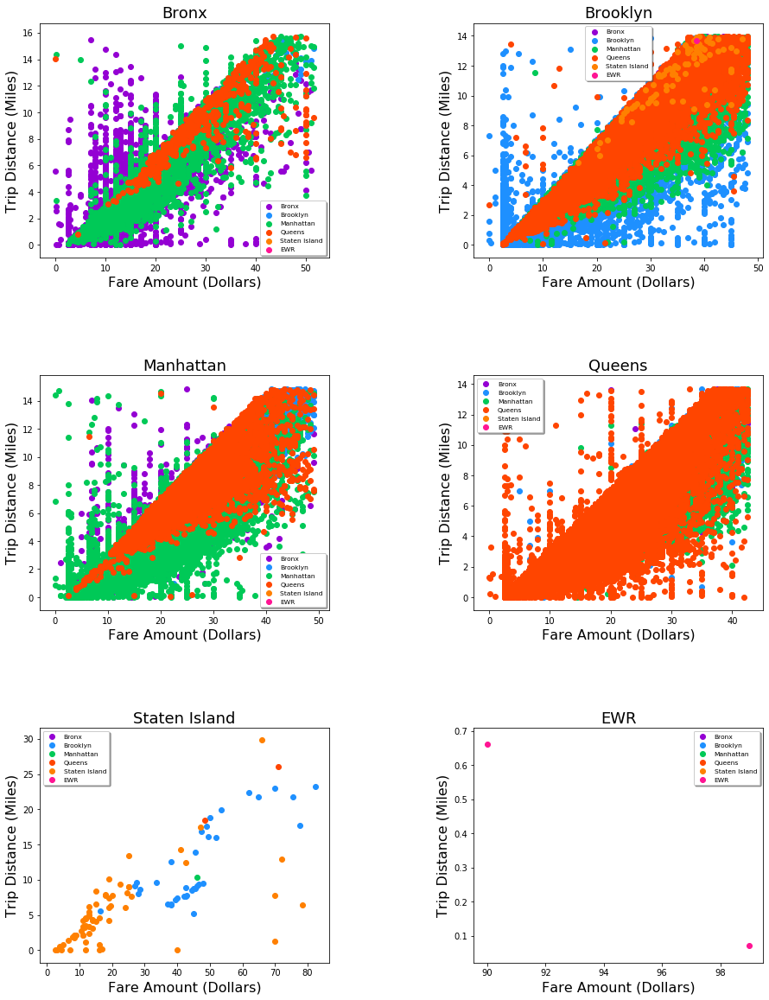

In [26]:
fig, ax = plt.subplots(3, 2, figsize=(15,20), gridspec_kw={'wspace':0.5, 'hspace':0.5})
k = [0,0,1,1,2,2]
column_labels = ['Bronx', 'Brooklyn', 'Manhattan', 'Queens', 'Staten', 'EWR']
labels = ['Bronx', 'Brooklyn', 'Manhattan', 'Queens', 'Staten Island', 'EWR']
colors = ['#9400D3','#1E90FF','#00C957','#FF4500','#FF8000','#FF1493']
Pearson = []

for i in range(len(labels)):
    for j in range(len(labels)):
        ax[k[i],i % 2].scatter(globals()[str(column_labels[i])][column_labels[j]]['fare_amount'],
                               globals()[str(column_labels[i])][column_labels[j]]['trip_distance'],color=colors[j])
    ax[k[i],i % 2].set_title(labels[i], fontsize=18)
    ax[k[i],i % 2].set_xlabel('Fare Amount (Dollars)', fontsize='16')
    ax[k[i],i % 2].set_ylabel('Trip Distance (Miles)', fontsize='16')
    ax[k[i],i % 2].legend(labels, prop={'size': 7.5}, shadow=True)
    Pearson.append(pearsonr(globals()[str(column_labels[i])+'_PU']['fare_amount'],
                            globals()[str(column_labels[i])+'_PU']['trip_distance']))

xlabels = [labels]    
ylabels = ['Pearson','p-value']
stats_df = pd.DataFrame(Pearson,xlabels,ylabels)  

In [27]:
display(stats_df)

,Pearson,p-value
Bronx,0.915304,0.000000e+00
Brooklyn,0.953617,0.000000e+00
Manhattan,0.951152,0.000000e+00
Queens,0.947816,0.000000e+00
Staten Island,0.777674,6.777883e-23
EWR,-1.000000,1.000000e+00


• We will revisit the scatter plots now that the outliers have been removed from the earlier pre-processing step. As expected, each plot exists on the same scale and provides the relationship between Trip Distance and Fare amount. Each scatter plot is in terms of the pickup location while each point is color coated in terms of the dropoff location. In general, a positive correlation exists between the two variables per location. 

• Note: Unknown locations were omitted because they took away from the visual contrast of the scatter plots

• In terms of the cases of interborough travel for The Bronx, Brooklyn, Manhattan and Queens, a majority of the local dropoffs are confined to the lower left corner of the plot. This makes sense as most fares would typically be 2-3 miles or less per trip and corresponding fare would be 10-15 dollars.

• Interborough travel also exhibits some extreme circumstances between Trip Distance and Fare Amount. There are some instances where a passenger was taken a large distance (over 10 miles) but did not pay more than 20 dollars for their trip. The opposite case also exists where the trip barely exceeded 1-2 miles but yielded a fare well over 20 dollars.

• While these cases are rare, they are noteworthy to mention in the context of realistic scenarios. In an instance where the trip distance is high and the fare rate was low, the passenger could  have negotiated the fare with the driver to a lower rate or the trip could have been during a time where extras did not apply. For the low trip distance high fare case, the driver could have had a bad experience with a passenger and raised the fare due to some penalty. Alternatively, there simply could have been an extra charge due to the trip being during the weekday rush hour which would also increase the probability of traffic and application of extra charges due time stopped or traveling below 6 mph.  

• According to freetoursbyfoot.com extra rates apply as such:
    - From 4 pm to 8 pm on weekdays, you will pay an additional $1.00. 
- From 8 pm to 6 am, you will pay an additional $0.50. 
    - When the taxi is moving, you pay $0.50 per 1/5 of a mile (moving at or above 6 miles per hour If the taxi is sitting 
  still or must slow down due to traffic, the charge is $0.50 for 2 minutes of time stopped or traveling below 6 mph.

# Percentage of Taxi Dropoffs with Tips

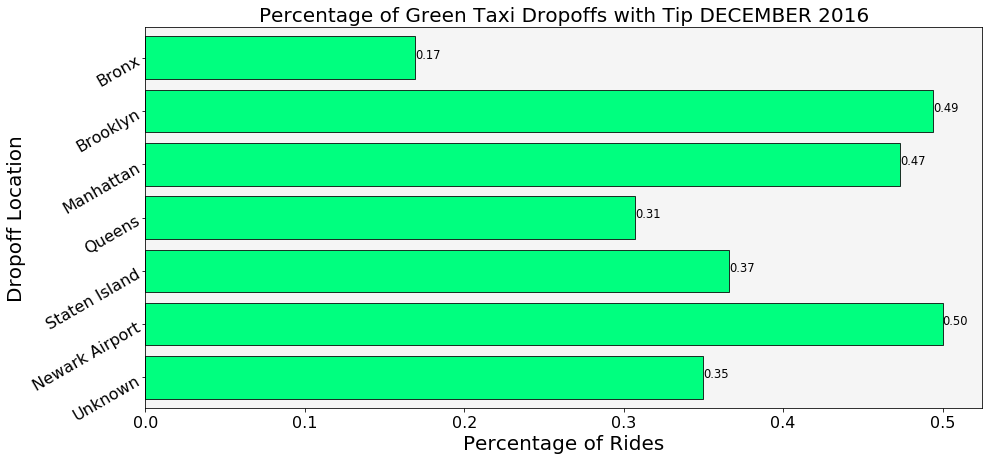

In [28]:
fig, ax = plt.subplots(figsize=(15,7))

tips_percentage = []
column_labels = ['Bronx', 'Brooklyn', 'Manhattan', 'Queens', 'Staten', 'EWR', 'Unknown']
labels = ['Bronx', 'Brooklyn', 'Manhattan', 'Queens', 'Staten Island', 'Newark Airport', 'Unknown']


for i in range(len(Location)):  
    tips = len(globals()[str(column_labels[i])+'_DO'][globals()[str(column_labels[i])+'_DO']['tip_amount'] > 0])
    calculation = tips/len(globals()[str(column_labels[i])+'_DO'])
    tips_percentage.append(calculation)

ax.barh(labels,tips_percentage,color='springgreen',edgecolor='k', linewidth='0.8',)
ax.set_title('Percentage of Green Taxi Dropoffs with Tip DECEMBER 2016', fontsize='20')
ax.set_xlabel('Percentage of Rides', fontsize='20')
ax.set_ylabel('Dropoff Location', fontsize='20')
ax.margins(y=0.025)
plt.gca().patch.set_facecolor('whitesmoke')
ax.invert_yaxis()

plt.xticks(fontsize=16) # x-axis formatting
plt.yticks(rotation=30, fontsize=16, ha='right', rotation_mode='anchor') # y-axis formatting

for index, value in enumerate(tips_percentage):
    plt.text(value, index, str("{:0.2f}".format(value)), fontsize=11.5)

plt.show()

• Among all dropoff locations, riders going to Newark Airport were most conscientious of giving their driver a tip. Likely due to travel for business trips, so the principle of rewarding timely arrival for flights was valued.

• For dropoffs in Manhattan and Brooklyn, riders provided their drivers tips for almost half of the rides.

• For dropoffs in Queens, Staten Island and Unknown locations, drivers see only about a 1 in 3 chance of receiving a tip at the end of a fare.

• The Bronx was the worst with tipping with a mere 17% of rides providing extra money for their driver. 

# Comparison of the Average Trip Distance, Fare Amount and Tip Amount over a 24-hour period 

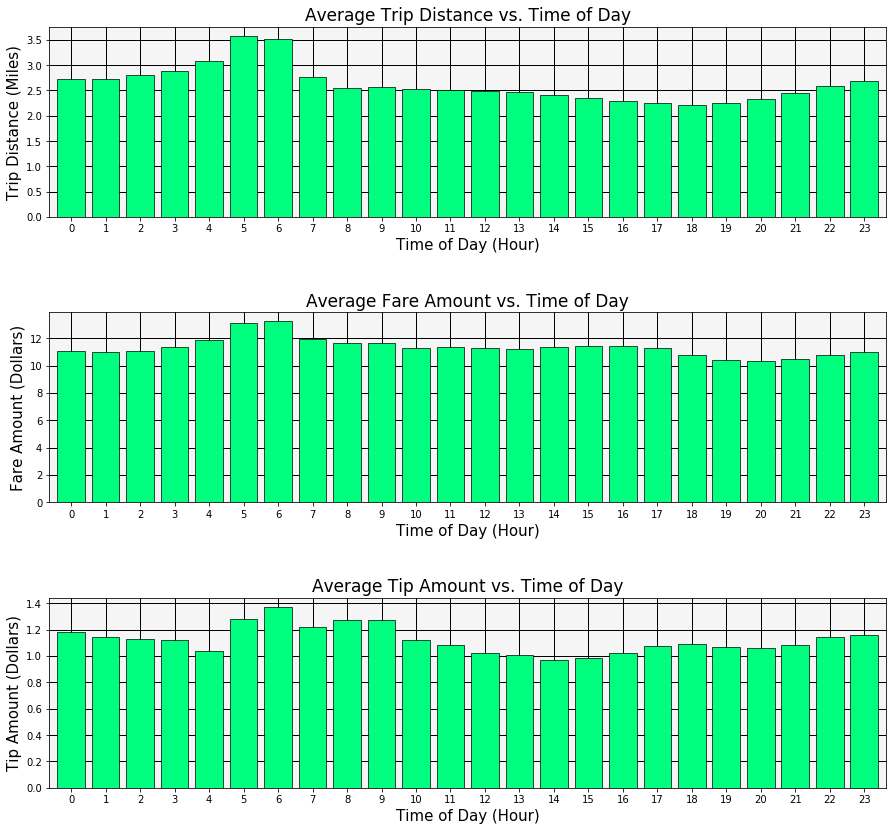

In [29]:
fig, ax = plt.subplots(3,1,figsize=(15,14),gridspec_kw={'wspace':0.5, 'hspace':0.5})

df_sort = df.copy()
x_axis = np.arange(0, 24)

params = ['trip_distance','fare_amount','tip_amount']
labels = ['Trip Distance','Fare Amount','Tip Amount']
y_labels = ['Trip Distance (Miles)','Fare Amount (Dollars)','Tip Amount (Dollars)']

for i in range(len(params)):
    df_sort.index = df_sort['lpep_pickup_datetime']
    a = ax[i].bar(x_axis,df_sort[params[i]].groupby(df_sort.index.hour).mean(),color='springgreen',edgecolor='k',linewidth='0.7',label=x_axis[i])
    ax[i].set_title('Average'+' '+labels[i]+' '+'vs.'+' '+'Time of Day',fontsize=17)
    ax[i].set_xlabel('Time of Day (Hour)',fontsize=15)
    ax[i].set_ylabel(y_labels[i],fontsize=15)
    ax[i].grid(True, zorder=1, color='k', linestyle='-', linewidth=1)
    ax[i].set_axisbelow(True)
    ax[i].margins(x=0.01)
    plt.sca(ax[i])
    plt.gca().patch.set_facecolor('whitesmoke')
    plt.xticks(x_axis,x_axis)

• As we cycle through the day, we see that the hours of 5AM and 6AM show the highest average Trip Distance, Fare, and Tip Amount. Considering that the morning rush hour window typically lasts from 7:30AM to to 9AM, these events would be pre-morning rush hour travel times.

• Given that there is a linear correlation between Trip Distance and Fare Amount it follows logically that these two variables would see their average amounts peak relatively around the same time. Tips are expected to be higher than average as well because the amount given is typically based off 10-15% of the fare.

• The afternoon rush hour window is often defined as 4:30PM to 7PM. About 1-2 hours into the afternoon rush, average trip distance beings to wane because more of the dropoffs become local. The average fare amount tends to wane more towards the end of rush hour as more people would already be home from work at that time by other means of transportation.

• Finally, the average tip amount takes a slight decrease during the late morning and early afternoon hours (the dead zone of time between the morning and afternoon rush hours).

• Highest Averages: Trip Distance 3.5 miles (5AM), Fare Amount 12.50 dollars (6AM), Tip amount 1.37 dollars (6AM)

• Lowest Averages: Trip Distance 2.25 miles (6PM), Fare Amount 10.10 dollars (8PM), Tip amount 0.90 cents (2PM)

• We will revisit this concept again in the next section by pickup location.

# Comparison of Hourly Average Trip Distance and Fare Amount by Location

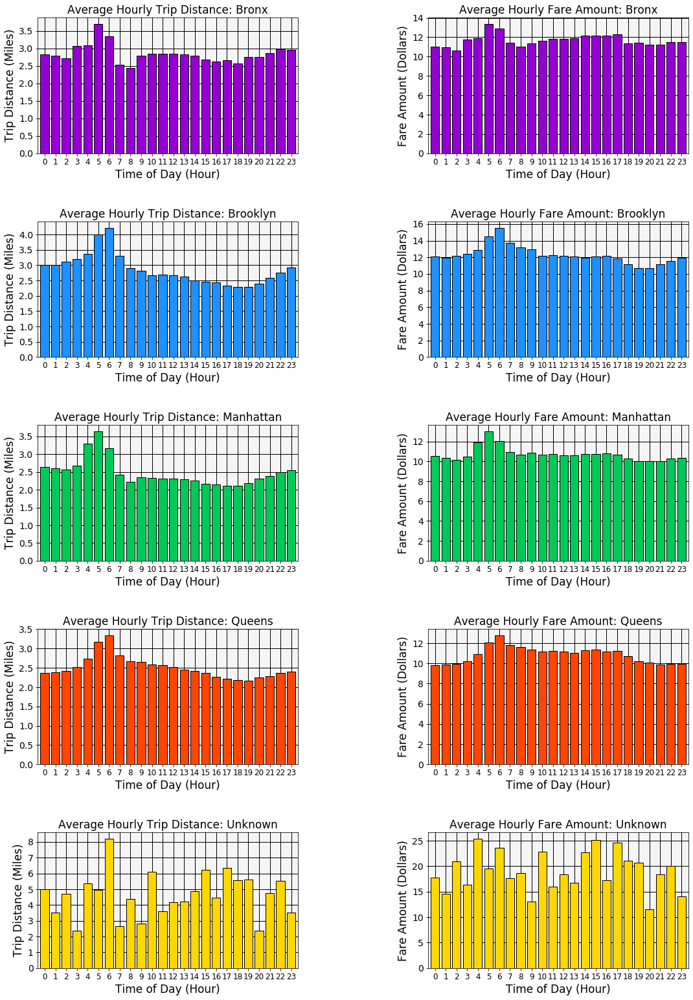

In [30]:
fig, ax = plt.subplots(5,2,figsize=(18,27),gridspec_kw={'wspace':0.5, 'hspace':0.5})
x_axis = np.arange(0, 24)

params = ['trip_distance','fare_amount']
column_labels = ['Bronx', 'Brooklyn', 'Manhattan', 'Queens','Unknown']
labels = ['Trip Distance','Fare Amount']
colors = ['#9400D3','#1E90FF','#00C957','#FF4500','gold']
y_labels = ['Trip Distance (Miles)','Fare Amount (Dollars)']

for j in range(len(column_labels)):
    df_sort = globals()[str(column_labels[j])+'_PU'].copy()
    for i in range(len(params)):
        df_sort.index = df_sort['lpep_pickup_datetime']
        ax[j,i].bar(x_axis,df_sort[params[i]].groupby(df_sort.index.hour).mean(),color=colors[j]
                        ,edgecolor='k',linewidth='1',label=x_axis[i])
        ax[j,i].set_title('Average Hourly'+' '+labels[i]+':'+' '+column_labels[j],fontsize=17)
        ax[j,i].set_xlabel('Time of Day (Hour)',fontsize=17)
        ax[j,i].set_ylabel(y_labels[i],fontsize=17)
        ax[j,i].grid(True, zorder=1, color='k', linestyle='-', linewidth=1)
        ax[j,i].set_axisbelow(True)
        ax[j,i].margins(x=0.010)
        plt.sca(ax[j,i])
        plt.gca().patch.set_facecolor('whitesmoke')
        plt.xticks(x_axis,x_axis,fontsize=12)
        plt.yticks(fontsize=14)
plt.show()

• Upon separating out the bar graphs by location, we see that the previously defined relationship across the entire city data exists in each of the 5 Boroughs as well.

• The peak times for highest average Trip Distance and Fare Amount still remains during the hours of 5 and 6AM. Trip Distance is usually the shortest at 6PM during the middle of the afternoon rush hour. Brooklyn and Manhattan see the most extreme inflections in average Trip Distance between these two times.

• Average Fare Amount appears to be the highest during the hours of 5AM and 6AM as well. This remains consistent to the dataset overall. Fare amounts tend to wane after the afternoon rush hour and taper off after 7PM for Queens. Brooklyn sees the highest uptick in average Fare Amounts into the night followed by nominal hourly increases for The Bronx and Manhattan.

• Pickups in Unknown locations appear to be anomalous compared to NYC. Average Trip Distance is the highest during the hour of 6AM which follows suit with the rest of the city. In the following hour trip distance seems to decrease drastically then work it's way up to a secondary peak at 6PM. Ironically, the case for Average Trip Distance is the complete opposite at an all time low for the rest of the city at this time.

• Average Fare Amount for Unknown locations is a bit more ambiguous but yields a higher amount at any time of the day relative to definitive NYC locations.

• The graphs for Staten Island and Newark Airport have been omitted due to lack of ride activity for every hour of the day.  

• Highest Average Trip Distance: Brooklyn 4.5 miles (6AM), Manhattan 3.75 miles (5AM), Bronx 3.75 miles (5AM), Queens 3.25 miles (6AM). 

• Lowest Average Trip Distance: Manhattan 2.2 miles (6PM), Brooklyn 2.25 miles (7PM), Queens 2.1 miles (7PM), Bronx 2.6 miles (6PM).

• Highest Average Fare: Brooklyn 15.00 dollars (6AM), Bronx 13.00 dollars (5AM), Manhattan 13.00 dollars (5AM), Queens 13.00 dollars (6AM)

• Lowest Average Fare: Manhattan 10.00 dollars (7PM), Queens 10.00 dollars (9PM), Brooklyn 11.00 dollars (7PM), Bronx 11.00 dollars (8PM)


# Average Trip Distance and Fare Amount for Each Day of the Week

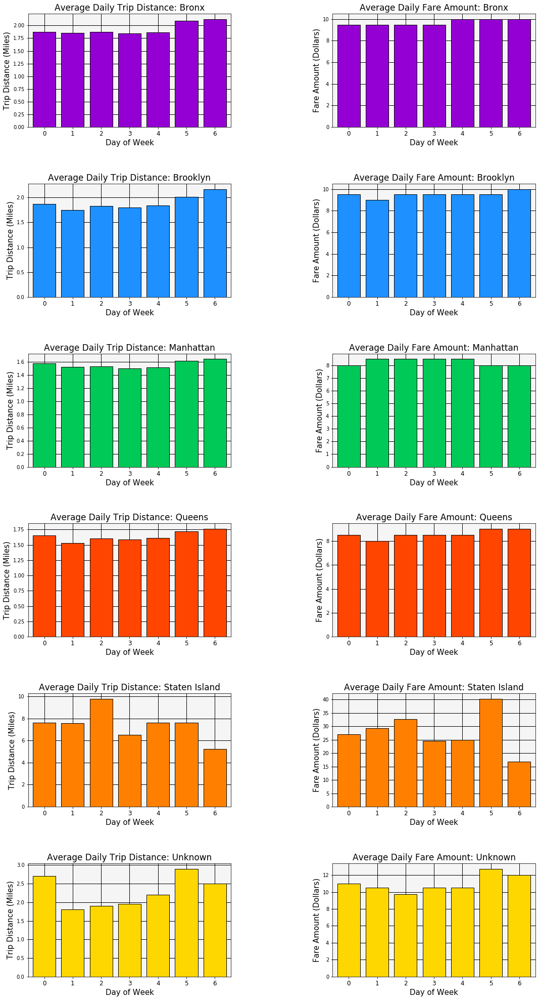

In [31]:
fig, ax = plt.subplots(6,2,figsize=(18,35),gridspec_kw={'wspace':0.5, 'hspace':0.5})
x_axis = np.arange(0, 7)
DOW = ['Sunday','Monday','Tuesday','Wednesday','Thursday','Friday','Saturday']
params = ['trip_distance','fare_amount']
column_labels = ['Bronx', 'Brooklyn', 'Manhattan', 'Queens', 'Staten','Unknown']
title_labels = ['Bronx', 'Brooklyn', 'Manhattan', 'Queens', 'Staten Island','Unknown']
labels = ['Trip Distance','Fare Amount']
colors = ['#9400D3','#1E90FF','#00C957','#FF4500','#FF8000','gold']
y_labels = ['Trip Distance (Miles)','Fare Amount (Dollars)']

for j in range(len(column_labels)):
    df_sort = globals()[str(column_labels[j])+'_PU'].copy()
    for i in range(len(params)):
        df_sort.index = df_sort['lpep_pickup_datetime']
        ax[j,i].bar(x_axis,df_sort[params[i]].groupby(df_sort.index.weekday).median(),color=colors[j]
                        ,edgecolor='k',linewidth='1')
        ax[j,i].set_title('Average Daily'+' '+labels[i]+':'+' '+title_labels[j],fontsize=17)
        ax[j,i].set_xlabel('Day of Week',fontsize=15)
        ax[j,i].set_ylabel(y_labels[i],fontsize=15)
        ax[j,i].grid(True, zorder=1, color='k', linestyle='-', linewidth=1)
        ax[j,i].set_axisbelow(True)
        ax[j,i].margins(x=0.025)
        plt.sca(ax[j,i])
        plt.gca().patch.set_facecolor('whitesmoke')
        plt.xticks(x_axis,x_axis,fontsize=12)
plt.show()

• Above series of bar graphs depict the weekly trend for Average Hourly Trip Distance and Fare Amount by pickup location. The numbers 0 through 6 correspond to the days Sunday through Saturday respectively.

• The Average Daily Trip Distance appears to be the highest on Fridays and Saturdays for 4 out of 5 Boroughs with exception of Staten Island. Since that Borough is considered the most extreme of the outer Boroughs, residents are less likely to leave the island on a Saturday as compared to most weekdays. Sunday sees just as much average traveling as a weekday for all Boroughs. Wednesday appears to be the least active day for traveling across all Boroughs.

• The Average Daily Fare Amount is relatively consistent across all Boroughs. Notably, there is a slight increase in the Fare Amount of Fridays and Saturdays for Queens while the opposite is true for Manhattan. Staten Island exhibits the most stark contrast throughout the week with Friday yielding an average Fare Amount of about 40 dollars.

## General Comments and Conclusion:

Location plays the largest role for where taxi drivers should look for fares. Holistically, Brooklyn, Queens, and Manhattan make up most of the demand for NYC at 95%. For the best opportunity to continuously be making consecutive fares these locations are the most favorable. 

Among these three Boroughs, Brooklyn seems to be the most favorable in terms of receiving the best tips but that comes at a tradeoff of traveling longer distances. Drivers are also likely to receive a tip for every other ride they do. One major disadvantage is Brooklyn's severely limited highway infrastructure as the only options are the Brooklyn-Queens Expressway, Belt Parkway and Prospect Expressway. In order to access the interior of Brooklyn there is no choice but to take local streets which would add more wear on a taxi drivers vehicle over time. The other advantages of Brooklyn is that it neighbors all of the other Boroughs except The Bronx. These other locations are accessible by bridge or tunnel. Brooklyn namely has three toll-free bridge options to get into Manhattan - Queens only has one. 

The Borough of Queens contains highway infrastructure that is the most navigable to access other parts of the city as well as for interborough travel. Consequently, we see that approximately 90% of all Queens pickups stay in Queens. This may prove more favorable in turnaround rates for fares because traffic will have less of an impact on the dwell time between fares. Taxi drivers need to be aware however that they will likely receive a tip for 1 out of every 3 rides that they do. Queens does have more single family residences than Manhattan or Brooklyn but there are also a fare share of apartments and transportation hubs such as Jamaica and Flushing. Despite both NYC airports being located in Queens, pickups in LaGuardia and JFK are not allowed unless prior arrangements are made. Unfortunately this severely limits additional Green Taxi opportunities in Queens. In general this location will yield about the same money for a taxi driver as in Manhattan - the demographics are just different.

Finally, of the top three Boroughs, Manhattan offers advantages that other locations do not. Notably it is the most sought after destination of the entire city. Despite the pickup restrictions of only being able to pick up passengers north of W110th Street and E96th Street Manhattan still does well with pick up demand at a close second behind Brooklyn. Average Hourly Trip Distance and Fare amounts are comparable to that of Queens but the likelihood of receiving a tip is higher at 1 out of every 2 rides completed. Manhattan also appears to have exclusive dropoff rights to The Bronx due to its proximal location and accessibility via the northern tip of Manhattan by bridge. Finally, the population density of Manhattan is approximately 72,000 People/Sq.Mile which is double that of either Brooklyn or The Bronx. This attribute is also favorable to making pickups in Manhattan and compensates for the aforementioned pickup restrictions as well.

The remaining locations would be viewed more so as dropoff locations because they only make up 5% of all Green Taxi demand. Picking up in The Bronx would still be beneficial to drivers however, because approximately 1 out of every 4 rides would lead a driver back into Manhattan anyway. The average Trip Distance and Fare Amount are comparable to that of Brooklyn (which is the highest of the Boroughs) despite have 1/10th less of the demand. Beware however, that Average Tip Amount in The Bronx is the lowest and only 17% of the rides yield a tip. As we can see The Bronx trades the convenience of proximity to Manhattan and higher fares for unreliable tipping. Finally, Staten Island, Newark and Unknown are considered oddball locations based on their geography, lack of proximity to Manhattan and lack opportunity to make consecutive fares. While the higher fare and tip amounts compensate for extra toll expenses and fuel costs the net profit is likely the same as working in the rest of the Boroughs. The incentive of a higher gross income is typically not worth the risk of extra travel distance for the driver nor the vehicle.

Conclusion: While taxi drivers cannot pick the destination of their passengers they can tactfully be aware of the probabilities of where a trip will end based on pickup location. Knowing this information a driver may choose a specific grouping of starting locations in order to maintain interborough trips, consecutive fares, avoid tolls and avoid large dwell times between trips by avoiding areas with poor infrastructure. We typically know that the most ideal rides should take place in one of the three major Boroughs, will have one passenger, travel a distance no more than two miles, bring in a fare of 11-12 dollars and receive a tip of 1-2 dollars. A good balance of all these factors is key to optimizing fares. In the final section we will sample the demand by the hour and see where the bulk of it manifests daily. From there we will predict future demand.  


# Final Section - Modeling Hourly Demand 

To adequately visualize a demand pattern over time we will focus on pickup dates and times. Utilizing the original Taxi Trip DataFrame, we will reassign the pickup datetimes as the index and resample by the hour. Another pre-processing step we will proactively do is calculate the sin and cos of the hour and day. These values have been appended to the original DataFrame and will be utilized as features for future modeling. The incentive behind doing this is rooted in converting categorial features into continuous ones. Features such as the day of the week and hour of the day are in fact continuous in nature since it follows a particular sequence. Since these features can be extracted from the datetime index it would be beneficial to take advantage of these recurring features. Finally we will also create a dictionary of hourly demand separated by location. We will visualize and characterize the data for locations which contain enough data points to model off of.

In [32]:
df_resample = df.copy()
df_resample.index = df_resample['lpep_pickup_datetime']
df_hourly = df_resample.resample('H').sum()
df_hourly = df_hourly.rename({'PULocationID': 'Hourly_Demand'}, axis=1)
df_hourly['sin_hour'] = np.sin(2*np.pi*df_hourly.index.hour/24)
df_hourly['cos_hour'] = np.cos(2*np.pi*df_hourly.index.hour/24)
df_hourly['sin_day'] = np.sin(2*np.pi*df_hourly.index.day/24)
df_hourly['cos_day'] = np.cos(2*np.pi*df_hourly.index.day/24)

data_hourly = {}
List = ['Bronx', 'Brooklyn', 'Manhattan', 'Queens', 'Staten', 'EWR', 'Unknown']
for i in range(len(List)):
    df_resample = globals()[str(List[i])+'_PU'].copy()
    df_resample.index = df_resample['lpep_pickup_datetime']
    df_hourly_list = df_resample.resample('H').sum()
    df_hourly_list = df_hourly_list.rename({'PULocationID': 'Hourly_Demand'}, axis=1)
    df_hourly_list['sin_hour'] = np.sin(2*np.pi*df_hourly_list.index.hour/24)
    df_hourly_list['cos_hour'] = np.cos(2*np.pi*df_hourly_list.index.hour/24)
    df_hourly_list['sin_day'] = np.sin(2*np.pi*df_hourly_list.index.day/24)
    df_hourly_list['cos_day'] = np.cos(2*np.pi*df_hourly_list.index.day/24)
    data_hourly[List[i]] = df_hourly_list # Dictionary of hourly demand separated by location

# Taxi Rides - Hourly Demand Time Series

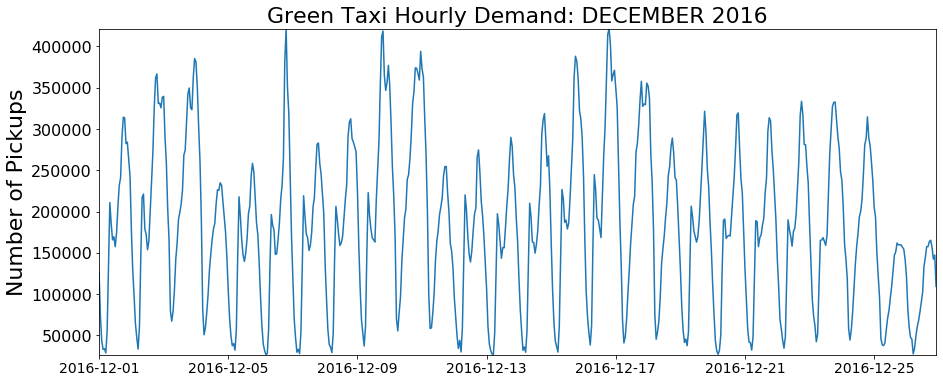

In [33]:
fig, ax = plt.subplots(figsize=(15,6))
ax.plot(df_hourly['Hourly_Demand'])
ax.set_title('Green Taxi Hourly Demand:'+' '+'DECEMBER 2016',fontsize=22)
ax.set_ylabel('Number of Pickups',fontsize=22)
ax.margins(x=0) # Removes gaps between x-ticks
ax.margins(y=0) # Removes gaps between y-ticks
plt.xticks(fontsize=14)
plt.yticks(fontsize=16) 
plt.show()

• A plot of the Green Taxi Hourly Demand of the entire city has been created in terms of all pickups. Note that the dates of December 27th to December 31st were missing from this data set.

• We will focus on modeling the demand in terms of pickups because it denotes the beginning of every ride. The dropoffs timeseries is useful to relate the outcome of the trip to it's start. However, in the case of absolute demand only the pickups are required.    

• Hourly demand is ideal because it provides the best transition of demand over time per day. Looking at demand by the minute would be too refined and daily demand would be too coarse. Sampling by the hour provides  the perfect balance for interpretation of the data. 
 
• It appears there are two general recurring surges in demand daily. One during the morning rush between the 8AM and 9AM hours and one during the afternoon rush during the 6PM and 7PM hours.

• Notably, the last few days of the month seem to taper in demand due to the holiday. There also appears to be a weekly trend but that will be more viewable in the next series of figures.

# Hourly Demand separated by Week 

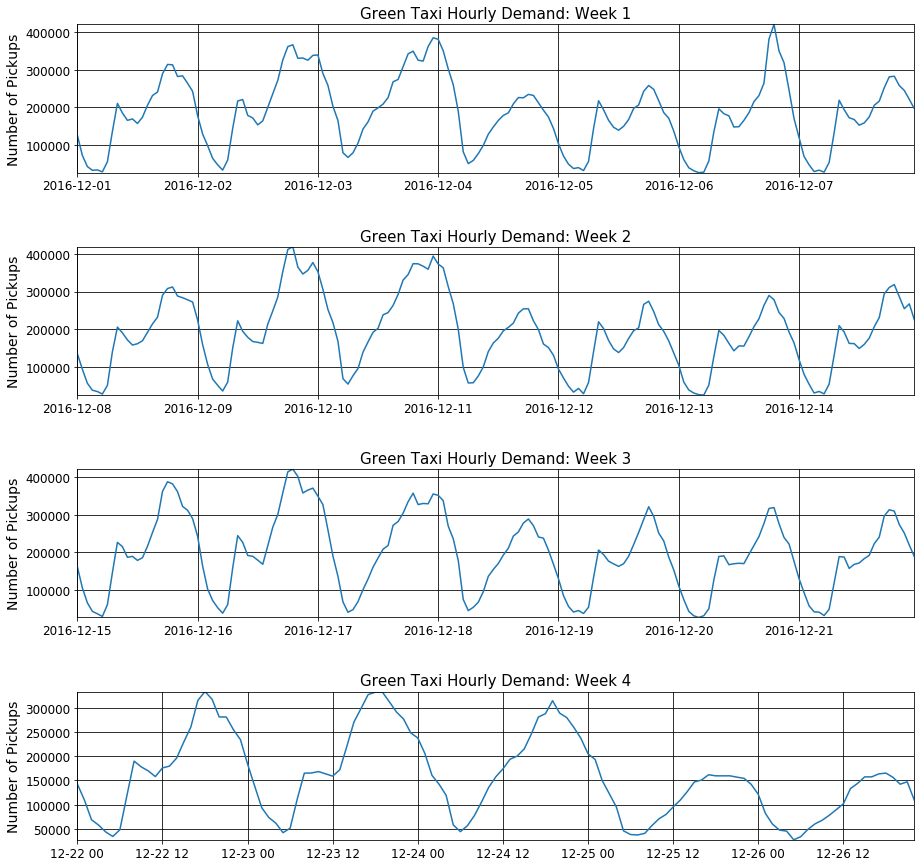

In [34]:
fig, ax = plt.subplots(4,1,figsize=(15,15), gridspec_kw={'wspace':0.5, 'hspace':0.5})
ff = [0,1,2,3]    
for i in range(len(ff)):
    if i < 3:
        ax[i].plot(df_hourly['Hourly_Demand'][(i*168):(i*168)+168])
        ax[i].set_title('Green Taxi Hourly Demand:'+' '+'Week'+' '+str(i+1),fontsize=15)
        ax[i].set_ylabel('Number of Pickups',fontsize=14)
        ax[i].grid(True, color='k', alpha=1)
        ax[i].margins(x=0) # Removes gaps between x-ticks
        ax[i].margins(y=0) # Removes gaps between y-ticks
        plt.sca(ax[i])
        plt.xticks(fontsize=12)
        plt.yticks(fontsize=12)
    else:
        ax[max(ff)].plot(df_hourly['Hourly_Demand'][(max(ff)*168):])
        ax[max(ff)].set_title('Green Taxi Hourly Demand:'+' '+'Week'+' '+str(i+1),fontsize=15)
        ax[max(ff)].set_ylabel('Number of Pickups',fontsize=14)
        ax[max(ff)].grid(True, color='k', alpha=1)
        ax[max(ff)].margins(x=0) # Removes gaps between x-ticks
        ax[max(ff)].margins(y=0) # Removes gaps between y-ticks
        plt.sca(ax[max(ff)])
        plt.xticks(fontsize=12)
        plt.yticks(fontsize=12)

• By separating hourly demand by week we can visualize the more subtle details of both the daily and hourly trends.

• Note that the first day of the month beings on a Thursday and ends on a Wednesday. Week 4 is three days short due to the data set and so the last day plotted is a Sunday.

• In general, the weekly trend suggests that there is a rise in demand on the weekends. The Fridays nights of the 9th and 16th saw the highest collective window of demand between from 7PM - 12AM. At it's highest point the demand peaked at over 350,000 rides or more hourly for the entire city during Friday and Saturday nights.

• Demand typically dies down at the beginning of the work week on Monday (see the 6th, 13th and 20th) for example, and then resets to peak demand the following Friday.

• The daily trend seems to waver in shape but it is clear that there are two distinct demand peaks as mentioned earlier. One in the mist of the AM rush and on during the PM rush. 

• These demand characteristics should also be taken into account by taxi drivers who are looking for consecutive fares. 

• Finally note that the weekly trend for the final week of the month behaves drastically different than the prior weeks. This is likely due to the holiday from December 24th - 25th and as a result collective taxi rides for the entire day are at an all-time low on the 25th. The demand profile for the 24th, 25th and 26th appear to be symmetric in their distributions with the peak time being 6PM. Compared to the other days in the week and days in prior weeks this suggests that far less people were taking taxis during the AM rush for business related purposes.

# Hourly Demand by Location

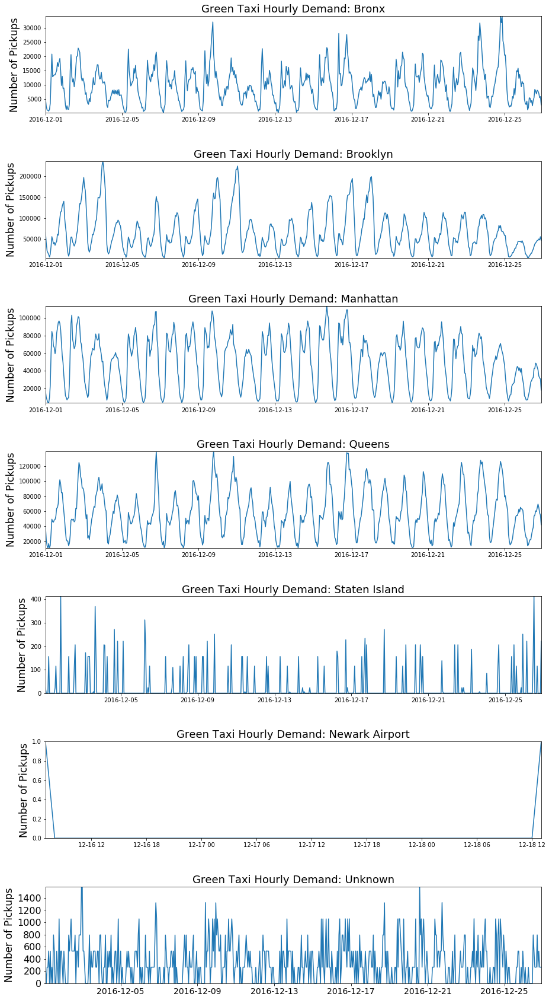

In [35]:
fig, ax = plt.subplots(7,1, figsize=(15,30),gridspec_kw={'wspace':0.5, 'hspace':0.5})
column_labels = ['Bronx', 'Brooklyn', 'Manhattan', 'Queens', 'Staten', 'EWR', 'Unknown']
title_labels = ['Bronx', 'Brooklyn', 'Manhattan', 'Queens', 'Staten Island', 'Newark Airport', 'Unknown']

for i in range(len(column_labels)):
    ax[i].plot(data_hourly[column_labels[i]]['Hourly_Demand'])
    ax[i].set_title('Green Taxi Hourly Demand:'+' '+title_labels[i],fontsize=18)
    ax[i].set_ylabel('Number of Pickups',fontsize=17)
    ax[i].margins(x=0) # Removes gaps between x-ticks
    ax[i].margins(y=0) # Removes gaps between y-ticks
    plt.xticks(fontsize=14)
    plt.yticks(fontsize=16) 
plt.show()

• Hourly Demand by Location puts into perspective which subsets of data are viable candidates to create models of.

• Evidently Brooklyn, Manhattan and Queens contain a sufficient amount of data as the curves of the daily trend are clear, concise and recurrent.

• The Bronx contains 1/10th the amount of data than the three aforementioned Boroughs. Visualizing the data however, suggests a model could be created despite the lack of data. The shape of the peaks does appear slightly jagged/noisy but that is a by-product of a lack of relative demand in that Borough and not a quality issue with the data itself.

• Staten Island and Newark definitively do not have enough data at 111 and 2 data points respectively. No interpretability lies in these plots and they unfortunately need to be excluded from modeling.

• Finally, we see that there were 796 pickups in Unknown locations. The interpretability for this plot is lacking as well so we will not model this location either.

## ARIMA Modeling

### • The ARIMA model was used to make baseline predictions for Time Series Forecasting.

### • We will check if the data is stationary or requires differencing utilizing an Augmented Dickey Fuller Test (ADF) which is a unit root test for stationarity.

### • The results of these models will be used as a means of comparison to other forecasting methods.


C:\Users\John\AppData\Roaming\Python\Python37\site-packages\statsmodels\regression\linear_model.py:1406: RuntimeWarning:

invalid value encountered in sqrt



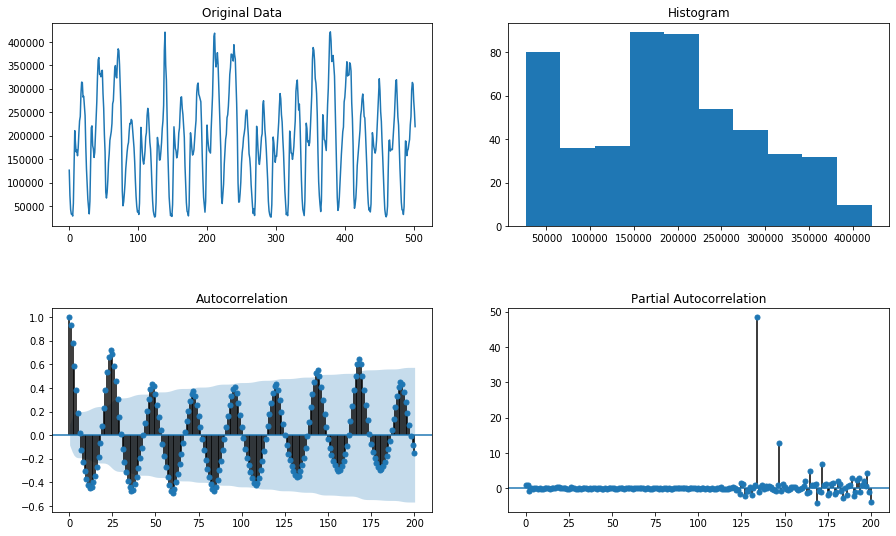

Test for Stationarity:
ADF Statistic: -3.189061
p-value: 0.020627


In [36]:
# View the Autocorrelation and Partial Autocorrelation plots and identify the points of stationarity
X = np.array(df_hourly['Hourly_Demand'])
fig, ax = plt.subplots(2,2, figsize=(15,9), gridspec_kw = {'wspace':0.2, 'hspace':0.4})

ax[0,0].plot(X[0:503])
ax[0,0].set_title('Original Data')

ax[0,1].hist(X[0:503])
ax[0,1].set_title('Histogram')

sm.graphics.tsa.plot_acf(X[0:503], lags=200, ax=ax[1,0])
sm.graphics.tsa.plot_pacf(X[0:503], lags=200, ax=ax[1,1])

plt.show() 

result = adfuller(X[0:503])
print('Test for Stationarity:')
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])

• In this case the p-value is less than 0.05 so the null hypothesis of the ADF test can be rejected that there is a unit root. We accept the alternative hypothesis that the time-series is stationary.

• Since we are dealing with suspected seasonal data based on the daily and weekly trends, let's confirm using the seasonal decomposition function.

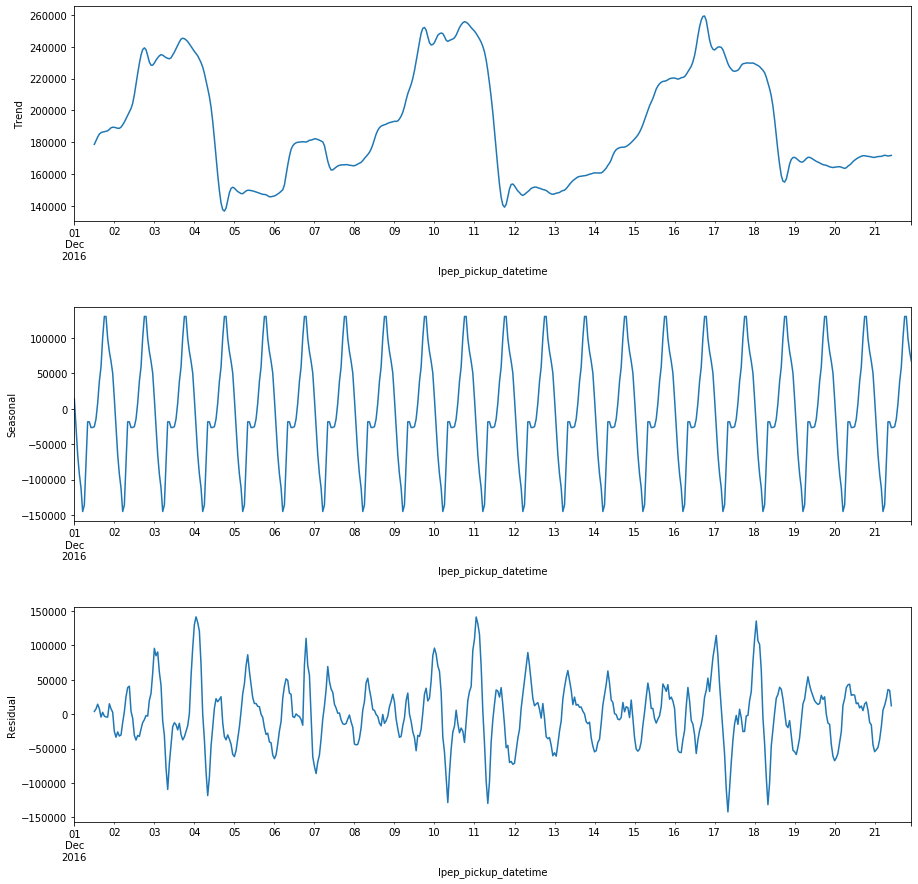

In [37]:
res = seasonal_decompose(df_hourly['Hourly_Demand'][0:503],model='add')

fig, (ax1,ax2,ax3) = plt.subplots(3,1, figsize=(15,15), gridspec_kw = {'wspace':0.2, 'hspace':0.4})

res.plot()
plt.close(2)

res.trend.plot(ax=ax1) # Trend
ax1.set_ylabel('Trend')
res.seasonal.plot(ax=ax2) # Seasonal
ax2.set_ylabel('Seasonal')
res.resid.plot(ax=ax3) # Residual
ax3.set_ylabel('Residual')

plt.show()

• The resultant figures show information regarding the observed time series, trend, seasonality and residual.

• The trend describes the long term progression of the series which appears to have a weekly cycle. The seasonality plot clearly shows a daily trend that exists daily throughout the month. Finally the residual shows the noise/irregular influences at every instance of time. 

• Considering these factors we will attempt to make a seasonal ARIMA with simple differencing. We will attempt to model with an auto regressive component (P=1), a moving average components (Q=1) and a daily seasonal component (s=7).

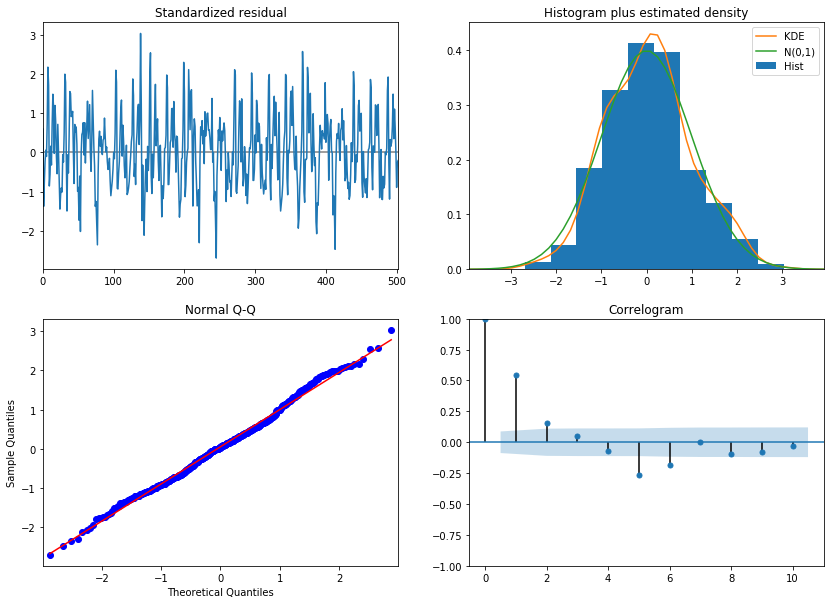

In [38]:
arimaSARIMAX = sm.tsa.statespace.SARIMAX(X[0:503], seasonal_order=(1,0,1,7), simple_differencing=True)
model_results = arimaSARIMAX.fit()
model_results.summary()

model_results.plot_diagnostics(figsize=(14, 10));

# Create a Class Named arimaMakerTaxi to Model and Plot the Results

In [39]:
class arimaMakerTaxi:    
    def __init__(self,data,Location,SplitDate,P,D,Q,s):
        self.logger = logging.getLogger('arimaMakerTaxi')

        X = np.array(data)
        l = data.index.tolist()
        dateTimeObj = datetime.datetime.strptime(str(SplitDate), '%Y-%m-%d %H:%M:%S')
        index_limit = l.index(dateTimeObj)
        train, self.test = X[:index_limit], X[index_limit:]  

        self.history = [x for x in train]                  # Declares the history as the "training set"
        self.predictions = list()                          # Declares a list for the predictions to be stored in
        
        self.P = P
        self.D = D
        self.Q = Q
        self.s = s
        self.Location = Location
        self.DOW = ['Sunday','Monday','Tuesday','Wednesday','Thursday','Friday','Saturday']
        self.residuals = None 
        self.logger.info('creating an instance of arimaMaker') 
        
    def train(self):
        
        self.logger.info('Training Model')
        for t in range(len(self.test)): 
            #  order=(self.p, self.d, self.q)
            model = SARIMAX(self.history, seasonal_order=(self.P, self.D, self.Q, self.s)) # Seasonal ARIMA function 
            #model = ARIMA(self.history, order=(self.p,self.d,self.q))     appended_data                # ARIMA function
            model_fit1 = model.fit(disp=0)                   
            self.residuals = model_fit1.resid
            output = model_fit1.forecast()
            yhat = output[0]
            self.predictions.append(yhat)                   # Appended array of the output or "predictions"
            obs = self.test[t]
            self.history.append(obs)                        # Appended array of the history or "training set"                    
            #print('predicted=%f, expected=%f' % (yhat, obs))
            self.model_fit1 = model_fit1
        self.logger.info('Model Created')
        
    def plotter(self):
        fig, ax = plt.subplots(2,2, figsize=(15,9), gridspec_kw = {'wspace':0.2, 'hspace':0.4})

        ax[0,0].plot(self.residuals[0:503])
        ax[0,0].set_title('Stationarized Data')

        ax[0,1].hist(X[0:503])
        ax[0,1].set_title('Histogram')

        sm.graphics.tsa.plot_acf(self.residuals[0:503], lags=200, ax=ax[1,0])
        sm.graphics.tsa.plot_pacf(self.residuals[0:503], lags=200, ax=ax[1,1])

        plt.show() 
        
        arimaSARIMAX = sm.tsa.statespace.SARIMAX(self.history[0:503], seasonal_order= (1,0,1,7), simple_differencing=True)
        model_results = arimaSARIMAX.fit()
        model_results.summary()

        model_results.plot_diagnostics(figsize=(15, 10));
        
        plt.show() 

        # Create a plot comparing the test and training data results 
        fig, ax1 = plt.subplots(1,1, figsize=(15,8))
        ax1.plot(self.test[:-1], color='blue', lw=2, label='Test Data')
        ax1.plot(self.predictions[1:], color='red', lw=2, label='Predictions')

        # Label and format plot 
        ax1.set_ylabel('Number of Pickups',fontsize=22)
        ax1.set_title('ARIMA Model:'+' '+str(self.Location),fontsize=22)

        ax1.margins(x=0) # Removes gaps between x-ticks
        ax1.grid(True, color='k', alpha=1)
        ax1.legend(prop={'size': 12},shadow=True) 
        plt.sca(ax1)
        plt.xticks(fontsize=14)
        plt.yticks(fontsize=16) 
   
        
    def stats(self):
        forecast = self.predictions[1:]
        actual = self.test[:-1]
        
        # Calculate the stats 
        MAE = np.mean(np.abs(forecast - actual))    
        square_error = np.mean((forecast - actual)**2)**.5
        MAPE = np.mean(np.abs(forecast - actual)/np.abs(actual))
        r2 = r2_score(actual,forecast)
        
        # Report the stats 
        print('Trained On: '+str("{:0.1f}".format(100-(len(self.test))*100/len(X)))+' %'+' '+
              'Tested On: '+str("{:0.1f}".format((len(self.test))*100/len(X)))+' %')
        print('\n')
        print('Location:'+' '+str(self.Location))
        print('Test MAE: %.3f' % MAE)
        print('Test RMSE: %.3f' % square_error)
        print('Test MAPE: %.3f' % MAPE)
        print('Test R\u00B2: %.3f' % r2)
        self.logger.info('Model Stats Calculated')
        
        return [MAE, square_error, MAPE, r2]
        
    def train_and_display(self):
        self.train()
        self.plotter()

# ARIMA Model Results - All of NYC

C:\Users\John\AppData\Roaming\Python\Python37\site-packages\statsmodels\regression\linear_model.py:1406: RuntimeWarning:

invalid value encountered in sqrt



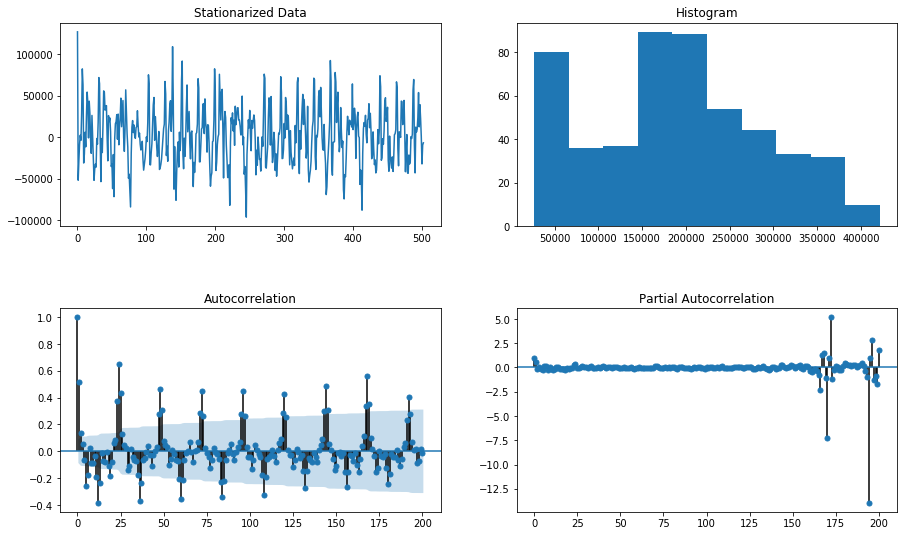

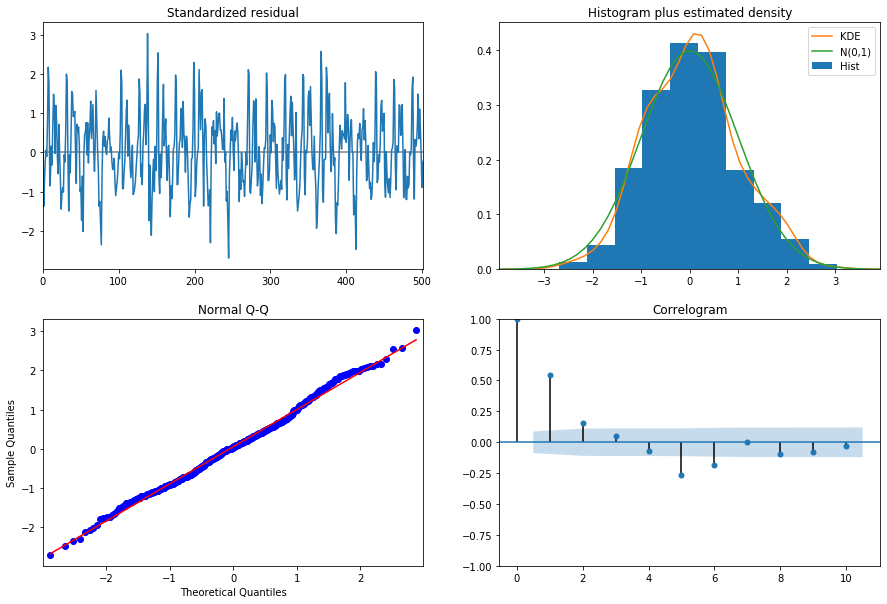

Trained On: 80.7 % Tested On: 19.3 %


Location: All of NYC
Test MAE: 6325.089
Test RMSE: 8322.404
Test MAPE: 0.054
Test R²: 0.990


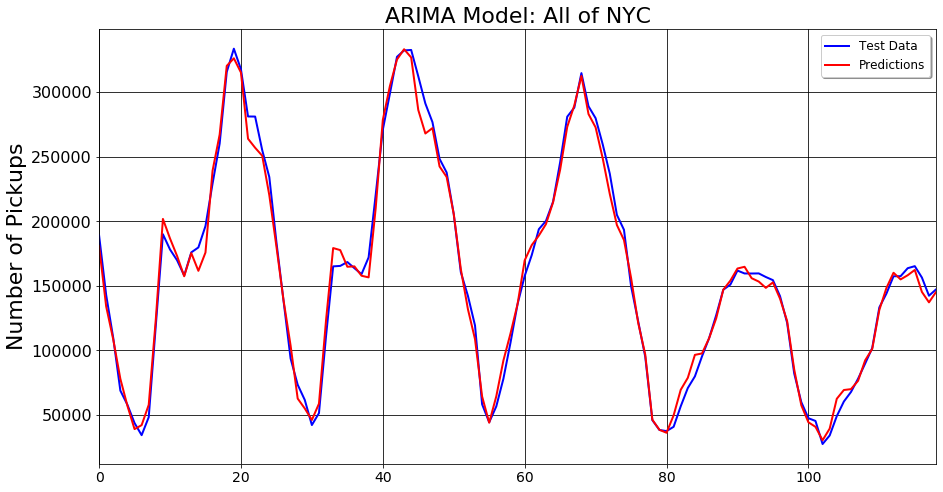

In [40]:
Arima_All = arimaMakerTaxi(data=df_hourly['Hourly_Demand'], Location='All of NYC', 
                       SplitDate='2016-12-21 23:00:00', P=1, D=0, Q=1, s=7)
Arima_All.train_and_display()
Arima_Stats_All = Arima_All.stats()

# ARIMA Model Results - Bronx

C:\Users\John\AppData\Roaming\Python\Python37\site-packages\statsmodels\regression\linear_model.py:1406: RuntimeWarning:

invalid value encountered in sqrt



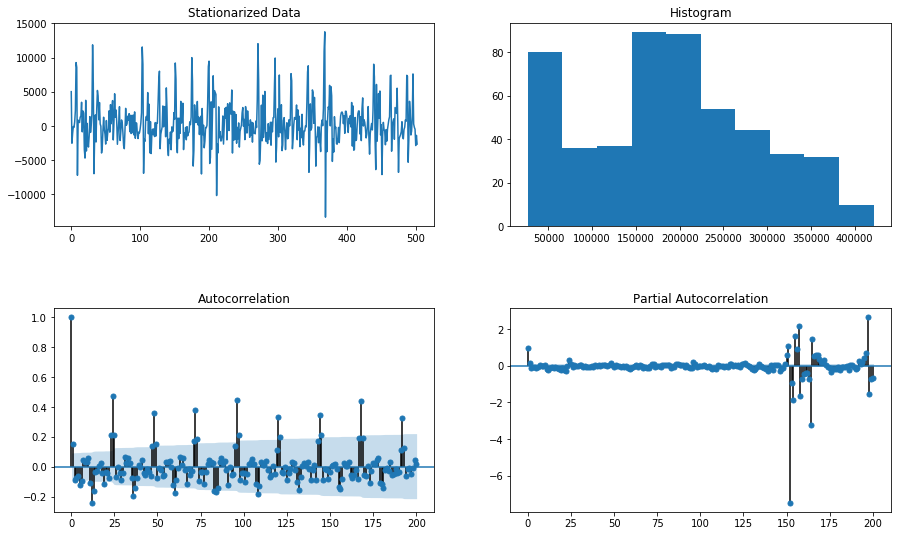

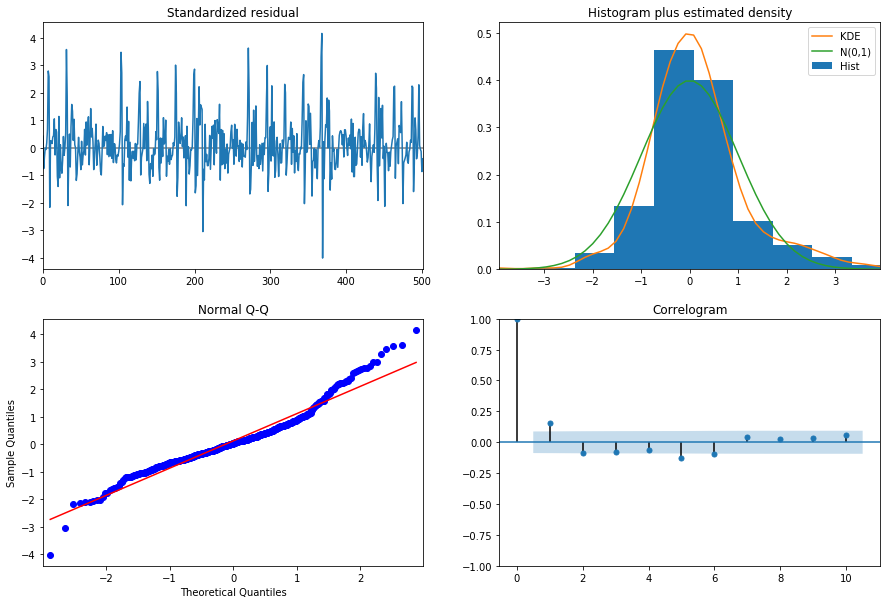

Trained On: 80.7 % Tested On: 19.3 %


Location: Bronx
Test MAE: 424.536
Test RMSE: 506.891
Test MAPE: 0.047
Test R²: 0.996


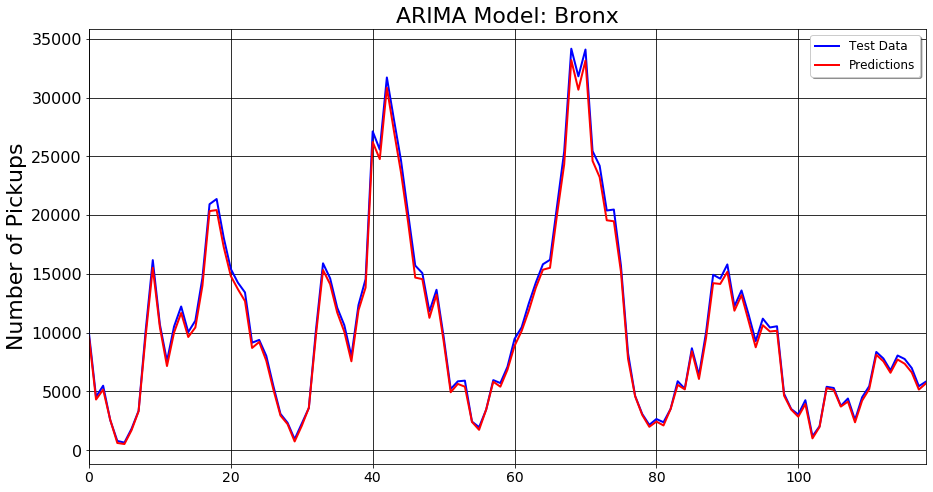

In [41]:
Arima_Bronx = arimaMakerTaxi(data=data_hourly['Bronx']['Hourly_Demand'], Location='Bronx', 
                       SplitDate='2016-12-21 23:00:00', P=1, D=0, Q=1, s=7)
Arima_Bronx.train_and_display()
Arima_Stats_Bronx = Arima_Bronx.stats()

# ARIMA Model Results - Brooklyn

C:\Users\John\AppData\Roaming\Python\Python37\site-packages\statsmodels\regression\linear_model.py:1406: RuntimeWarning:

invalid value encountered in sqrt



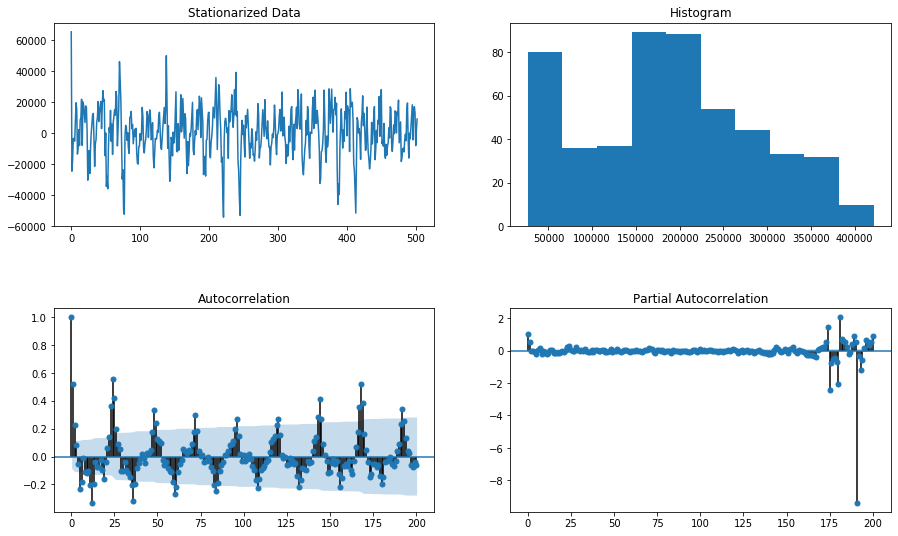

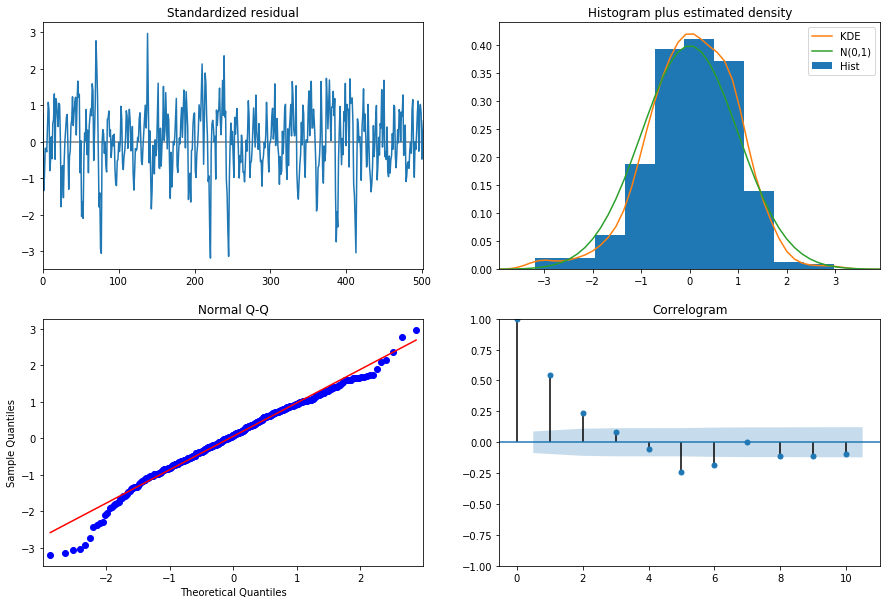

Trained On: 80.7 % Tested On: 19.3 %


Location: Brooklyn
Test MAE: 3517.333
Test RMSE: 4487.005
Test MAPE: 0.113
Test R²: 0.977


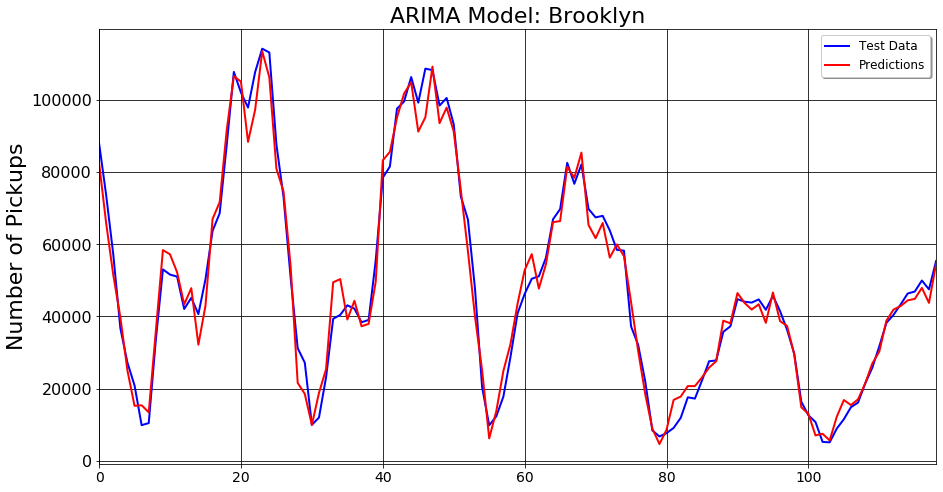

In [42]:
Arima_Brooklyn = arimaMakerTaxi(data=data_hourly['Brooklyn']['Hourly_Demand'], Location='Brooklyn', 
                       SplitDate='2016-12-21 23:00:00', P=1, D=0, Q=1, s=7)
Arima_Brooklyn.train_and_display()
Arima_Stats_Brooklyn = Arima_Brooklyn.stats()

# ARIMA Model Results - Manhattan

C:\Users\John\AppData\Roaming\Python\Python37\site-packages\statsmodels\regression\linear_model.py:1406: RuntimeWarning:

invalid value encountered in sqrt



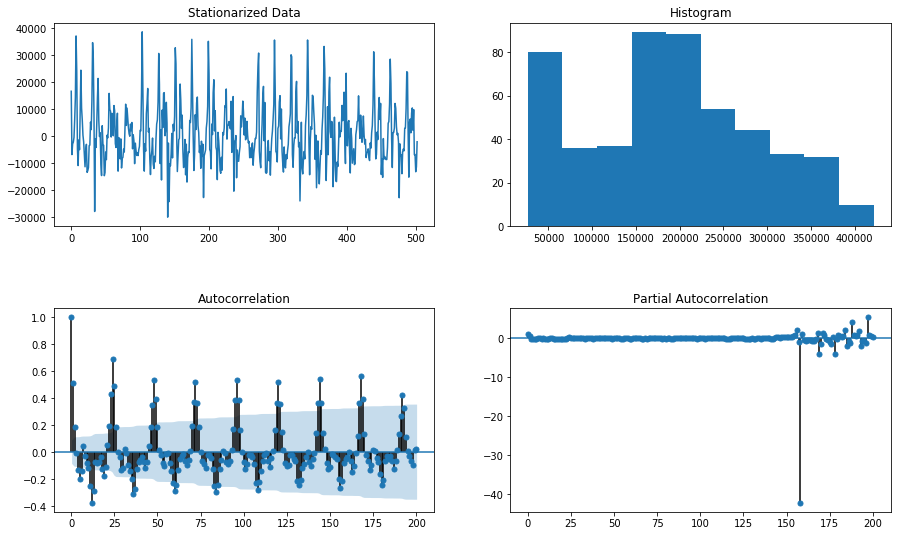

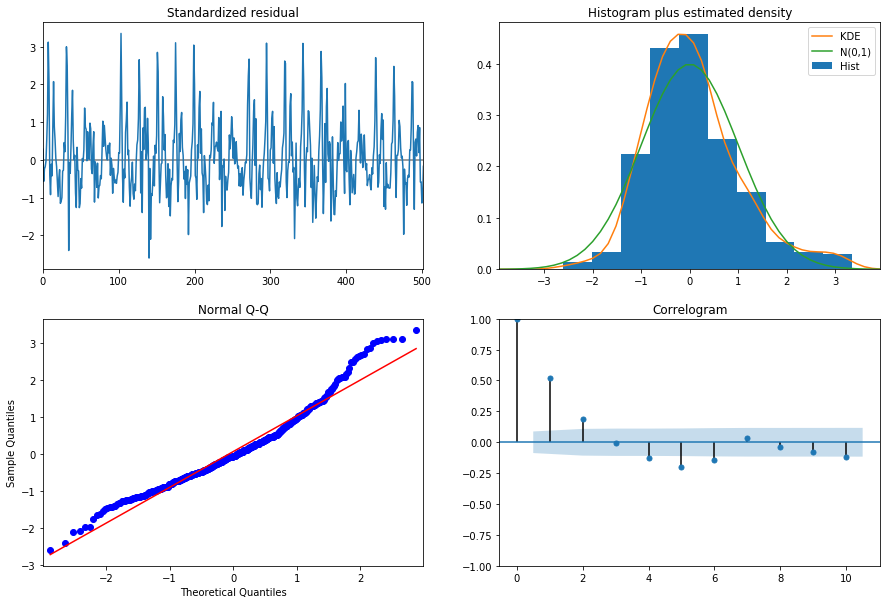

Trained On: 80.7 % Tested On: 19.3 %


Location: Manhattan
Test MAE: 1667.300
Test RMSE: 2143.395
Test MAPE: 0.064
Test R²: 0.991


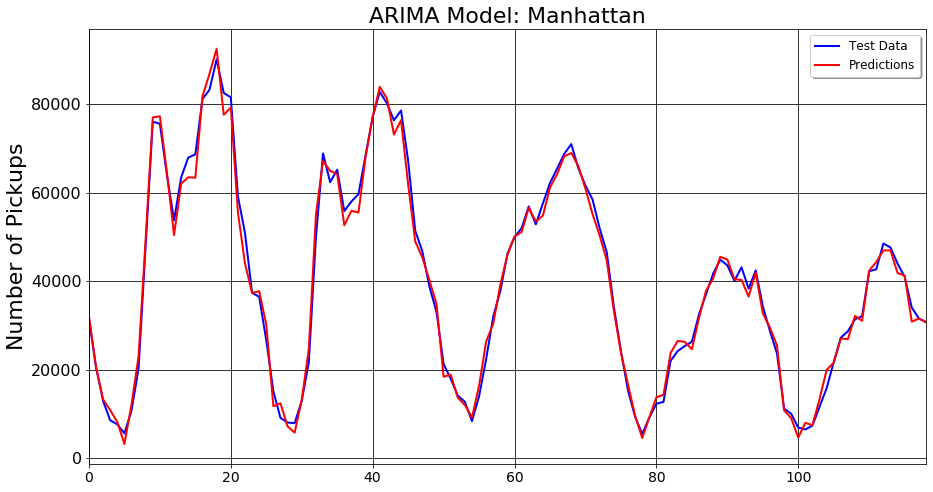

In [43]:
Arima_Manhattan = arimaMakerTaxi(data=data_hourly['Manhattan']['Hourly_Demand'], Location='Manhattan', 
                       SplitDate='2016-12-21 23:00:00', P=1, D=0, Q=1, s=7)
Arima_Manhattan.train_and_display()
Arima_Stats_Manhattan = Arima_Manhattan.stats()

# ARIMA Model Results - Queens

C:\Users\John\AppData\Roaming\Python\Python37\site-packages\statsmodels\regression\linear_model.py:1406: RuntimeWarning:

invalid value encountered in sqrt



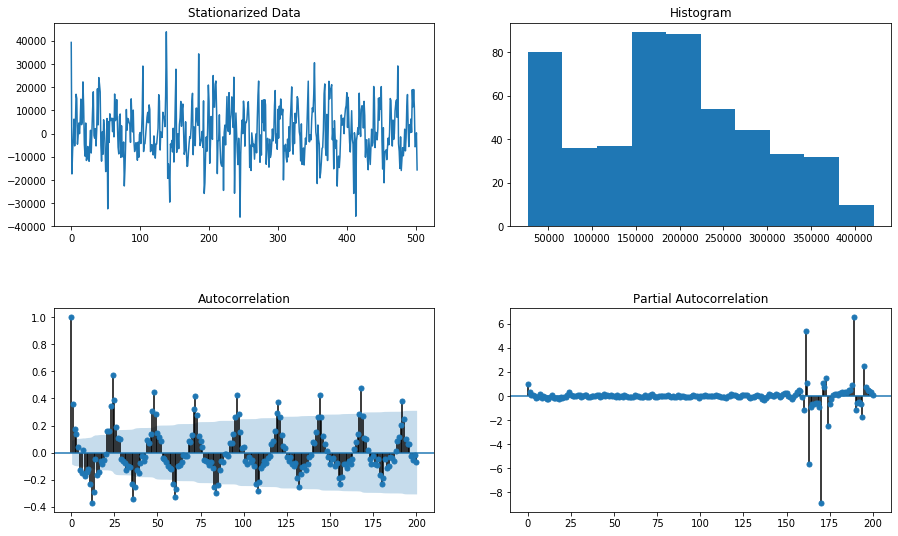

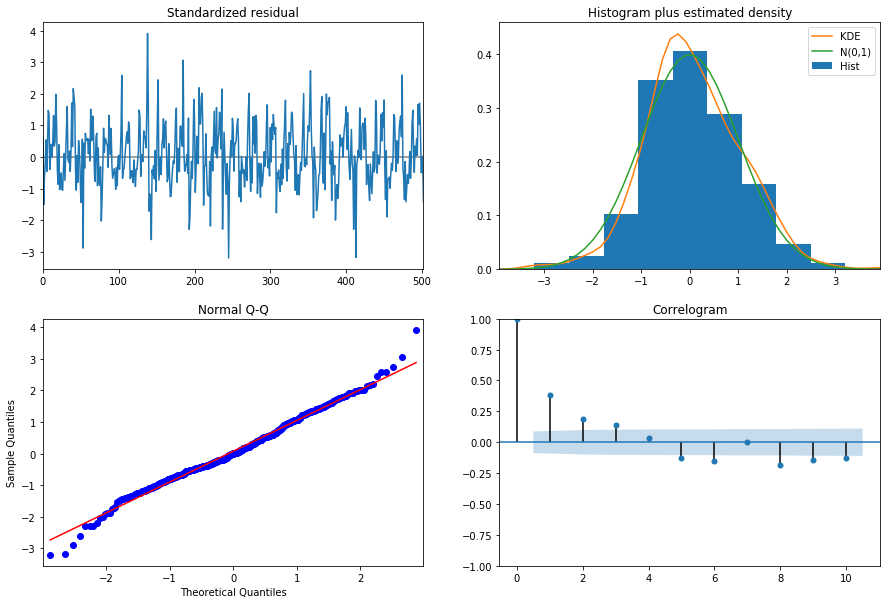

Trained On: 80.7 % Tested On: 19.3 %


Location: Queens
Test MAE: 1857.574
Test RMSE: 2409.945
Test MAPE: 0.040
Test R²: 0.994


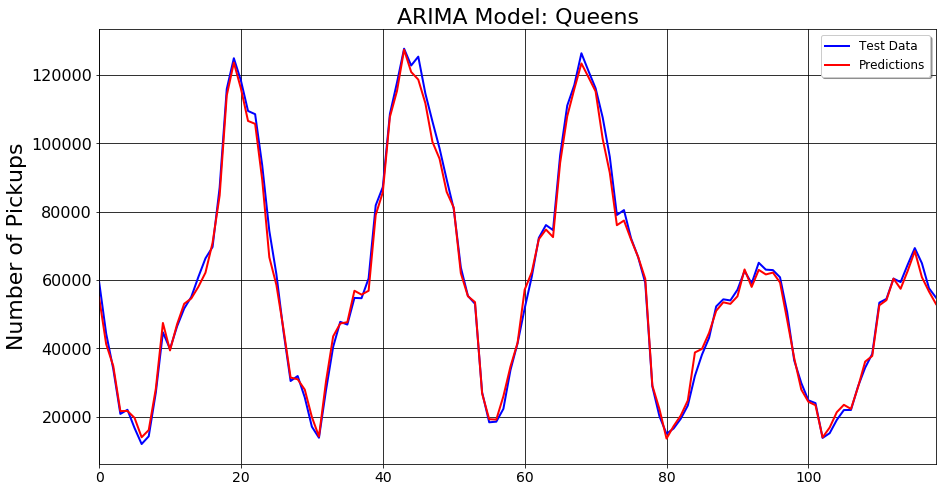

In [44]:
Arima_Queens = arimaMakerTaxi(data=data_hourly['Queens']['Hourly_Demand'], Location='Queens', 
                       SplitDate='2016-12-21 23:00:00', P=1, D=0, Q=1, s=7)
Arima_Queens.train_and_display()
Arima_Stats_Queens = Arima_Queens.stats()

The ARIMA models performed exceptionally well across all locations

# FbProphet Models 

### Create a function that accepts input data, a location and split date and executes the FbProphet Model. Display the forecast and show the model components.

In [45]:
def prophet_plot(data,Location,SplitDate):

    data['Datetime'] = data.index
    counts_hourly = data['Hourly_Demand'].to_frame()
    time = data['Datetime'].to_frame()
    dfweek = pd.concat([counts_hourly,time],axis=1)

    # Use the Prophet Model to assess Weekly and Daily Trends. Compare model to the actual results. 
    # Set up the time axis and split date 
    split_date = SplitDate # Split date for the train-test split

    # Apply the split date to perform a train-test split
    train_data = dfweek.iloc[dfweek.index <= split_date].copy()
    test_data = dfweek.iloc[dfweek.index > split_date].copy()

    # Assign the parameters for the Prophet model 
    model = Prophet(yearly_seasonality=False,weekly_seasonality=True) # Establish the model 
    model.fit(train_data.reset_index(drop=True).rename(columns={'Datetime':'ds','Hourly_Demand':'y'})) # Train the model
    predictions = model.predict(df=test_data.reset_index(drop=True).rename(columns={'Datetime':'ds'})) # Test the model 
    
    forecast = np.array(predictions['yhat'])
    actual = np.array(test_data['Hourly_Demand'])
    
    py.init_notebook_mode()
    # Plot the model results
    py.iplot(plot_plotly(model, predictions))
    
    MAE = np.mean(np.abs(forecast - actual))    
    square_error = np.mean((forecast - actual)**2)**.5
    MAPE = np.mean(np.abs(forecast - actual)/np.abs(actual))
    r2 = r2_score(actual,forecast)
    
    print('Location:'+' '+str(Location))
    print('Test MAE: %.3f' % MAE)
    print('Test RMSE: %.3f' % square_error)
    print('Test MAPE: %.3f' % MAPE)
    print('Test R\u00B2: %.3f' % r2)

    fig1, ax1 = plt.subplots(figsize=(10.5,4), gridspec_kw={'wspace':0.5, 'hspace':0.5}) 
    ax1.plot(data['Hourly_Demand'].to_frame())
    ax1.plot(predictions['ds'],forecast)
    ax1.set_title('Green Taxi Hourly Demand:'+' '+str(Location),fontsize=17)
    ax1.set_ylabel('Number of Pickups',fontsize=15)
    ax1.margins(x=0) # Removes gaps between x-ticks
    ax1.margins(y=0) # Removes gaps between y-ticks

    # Look at the model components
    fig = model.plot_components(predictions)
    
    return [MAE, square_error, MAPE, r2]

# FbProphet Model Results - All of NYC

Location: All of NYC
Test MAE: 55484.278
Test RMSE: 68130.052
Test MAPE: 0.535
Test R²: 0.339


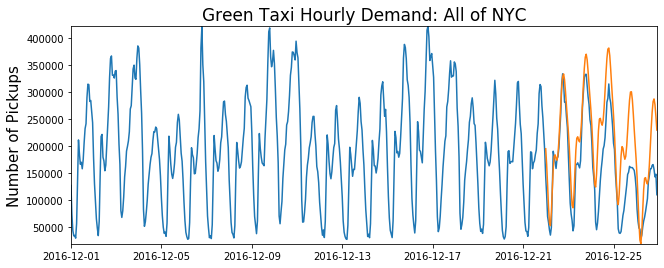

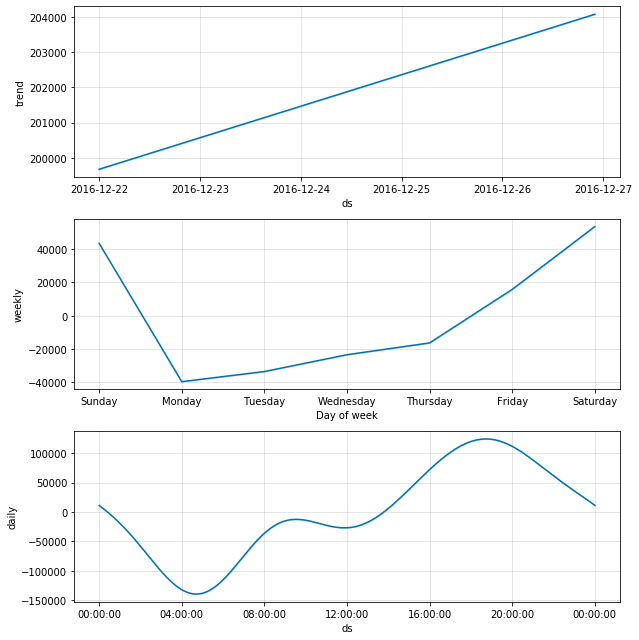

In [46]:
Prophet_Stats_All = prophet_plot(df_hourly,'All of NYC','2016-12-21 23:00:00')

# FbProphet Model Results - Bronx

Location: Bronx
Test MAE: 4394.705
Test RMSE: 6303.900
Test MAPE: 0.634
Test R²: 0.330


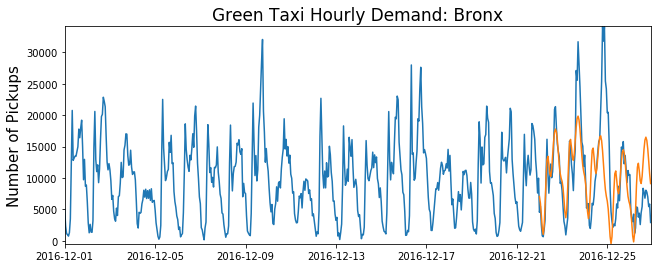

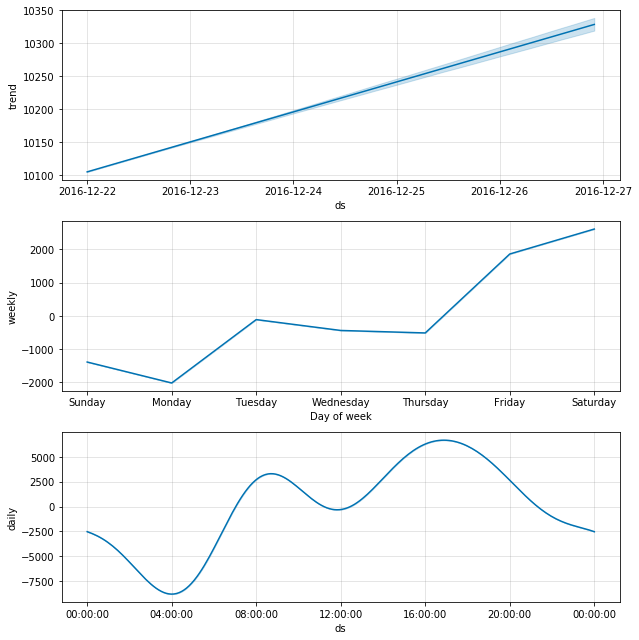

In [47]:
Prophet_Stats_Bronx = prophet_plot(data_hourly['Bronx'],'Bronx','2016-12-21 23:00:00')

# FbProphet Model Results - Brooklyn

Location: Brooklyn
Test MAE: 34352.672
Test RMSE: 42847.955
Test MAPE: 1.109
Test R²: -1.143


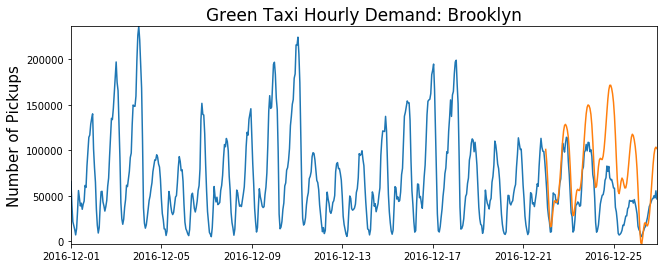

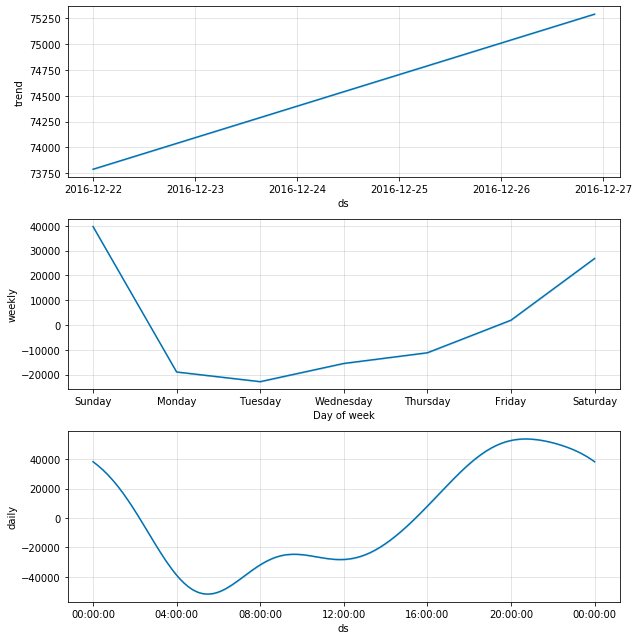

In [48]:
Prophet_Stats_Brooklyn = prophet_plot(data_hourly['Brooklyn'],'Brooklyn','2016-12-21 23:00:00')

# FbProphet Model Results - Manhattan

Location: Manhattan
Test MAE: 15938.190
Test RMSE: 19700.660
Test MAPE: 0.575
Test R²: 0.273


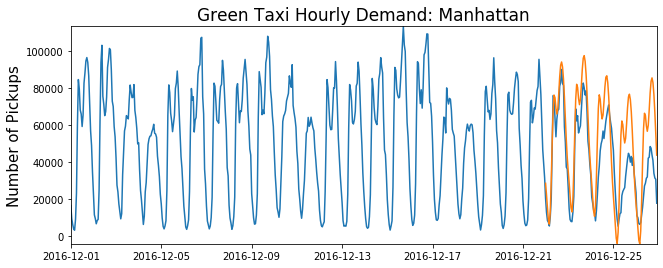

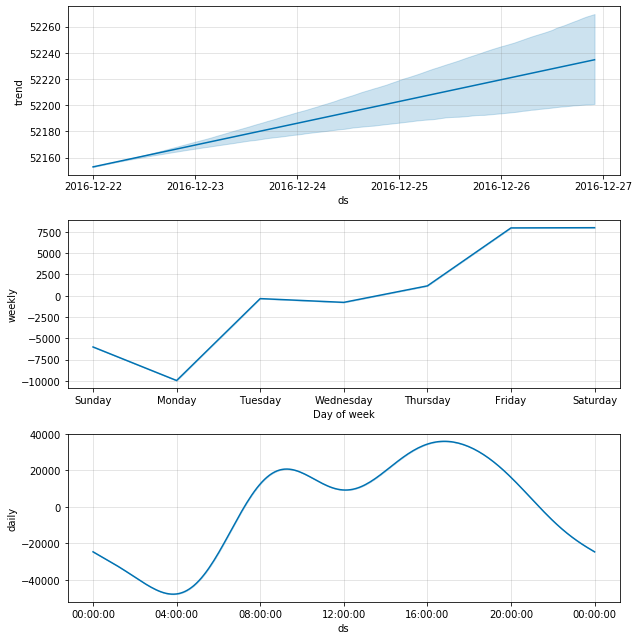

In [49]:
Prophet_Stats_Manhattan = prophet_plot(data_hourly['Manhattan'],'Manhattan','2016-12-21 23:00:00')

# FbProphet Model Results - Queens

Location: Queens
Test MAE: 13564.219
Test RMSE: 17334.751
Test MAPE: 0.368
Test R²: 0.711


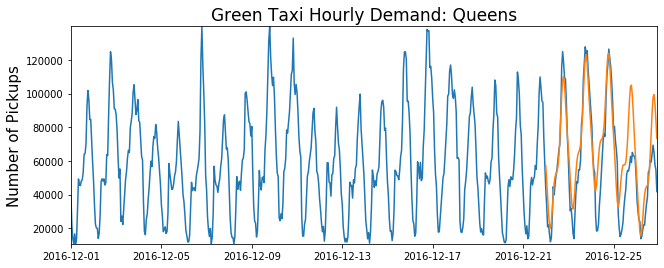

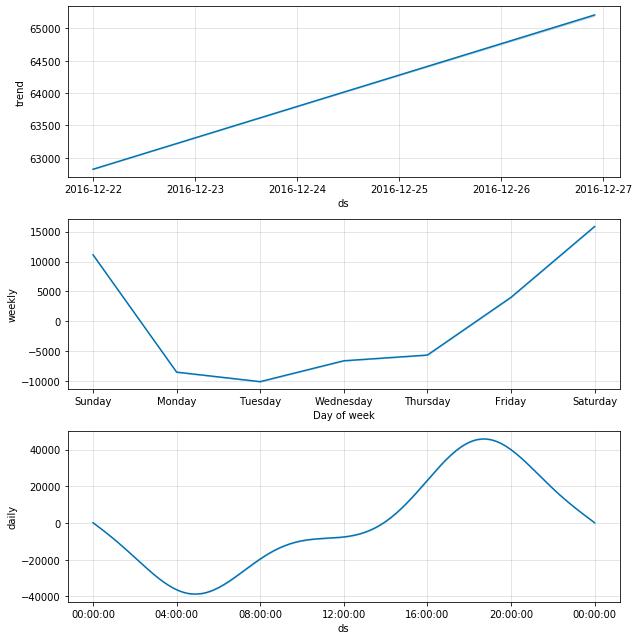

In [50]:
Prophet_Stats_Queens = prophet_plot(data_hourly['Queens'],'Queens','2016-12-21 23:00:00')

# LSTM Models

### Create a function which accepts input data, a location split date, a feature option, number of layer, number of epochs and batch size. The function will execute a LSTM model and return an overlay of the training data, test data and forecast. 

Note: The create_dataset function allows us to shift the y column one time step into the future. Since we are predicting hourly demand the next time step would be pecifically one hour into the future. This would be useful for taxi drivers because they can start working shifts on their own terms (at any hour of the day) depending on the prediction of demand for the next upcoming hour. Since they typically work shifts day by day, they are making the most informed decision relying on hourly updates as opposed to a broader forecast.

In [51]:
def lstmPlot(data, Location, SplitDate, features, layers, epochs, batch_size):    

    data2 = data[features]
    np.random.seed(0)

    split_date = '2016-12-21 23:00:00' # Split date for the train-test split

    # Apply the split date to perform a train-test split
    train = data2.iloc[data2.index <= split_date].copy()
    test = data2.iloc[data2.index > split_date].copy()

    features = ['sin_hour','cos_hour','sin_day','cos_day']

    feature_transformer = RobustScaler()
    HD_transformer = RobustScaler()

    feature_transformer = feature_transformer.fit(train[features].to_numpy())
    HD_transformer = HD_transformer.fit(train[['Hourly_Demand']])

    train.loc[:, features] = feature_transformer.transform(train[features].to_numpy())
    train['Hourly_Demand'] = HD_transformer.transform(train[['Hourly_Demand']])

    test.loc[:, features] = feature_transformer.transform(test[features].to_numpy())
    test['Hourly_Demand'] = HD_transformer.transform(test[['Hourly_Demand']])

    def create_dataset(X, y, time_steps):
        Xs, ys = [], []
        for i in range(len(X) - time_steps):
            v = X.iloc[i:(i + time_steps)].values
            Xs.append(v)        
            ys.append(y.iloc[i + time_steps])
        return np.array(Xs), np.array(ys)

    time_steps = 1

    # reshape to [samples, time_steps, n_features]
    X_train, y_train = create_dataset(train, train.Hourly_Demand, time_steps)
    X_test, y_test = create_dataset(test, test.Hourly_Demand, time_steps)

    model = Sequential()
    model.add(LSTM(units=layers, input_shape=(X_train.shape[1], X_train.shape[2])))
    model.add(Dropout(rate=0.2))
    model.add(Dense(units=1))
    model.compile(loss='mean_squared_error', optimizer='adam')

    history = model.fit(X_train, y_train, epochs=epochs, batch_size=batch_size, validation_split=0.1, verbose=0, shuffle=False)

    ##
    # Compare the train and validation loss curves  
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('Model Train vs Validation Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper right')
    plt.show()

    y_pred_train = model.predict(X_train)
    y_pred_test = model.predict(X_test)
    y_train_inv = HD_transformer.inverse_transform(y_train.reshape(1, -1))
    y_test_inv = HD_transformer.inverse_transform(y_test.reshape(1, -1))
    y_pred_train_inv = HD_transformer.inverse_transform(y_pred_train)
    y_pred_test_inv = HD_transformer.inverse_transform(y_pred_test)

    actual_train = y_train_inv.flatten()
    actual_test = y_test_inv.flatten()
    forecast_train = y_pred_train_inv.flatten()
    forecast = y_pred_test_inv.flatten()

    # Calculate and display the stats (MSE)
    trainScore = math.sqrt(mean_squared_error(actual_train, forecast_train))
    print('Train Score: %.2f RMSE' % (trainScore))
    testScore = math.sqrt(mean_squared_error(actual_test, forecast))
    print('Test Score: %.2f RMSE' % (testScore))

    # Create a plot displaying the train test and predictions from the LSTM model
    fig1, ax1 = plt.subplots(figsize=(15,7), gridspec_kw = {'wspace':0, 'hspace':1}) #Establish a subplot

    # Plot the Training Data, Test Data and Predictions 
    ax1.plot(np.arange(0, len(y_train)),actual_train, lw=2.5, color='tab:blue', label='Training Data')
    ax1.plot(np.arange(len(y_train), len(y_train) + len(y_test)),actual_test, lw=2.5, color='darkorange', label='Test Data')
    ax1.plot(np.arange(len(y_train), len(y_train) + len(y_test)),forecast, lw=2.5, color='green', label='Forecast')

    # Label and format plot
    ax1.set_title('LSTM Model:'+' '+str(Location),fontsize=20)
    ax1.set_ylabel('Number of Pickups', fontsize=20)

    ax1.margins(x=0) # Removes gaps between x-ticks
    ax1.margins(y=0) # Removes gaps between y-ticks
    ax1.grid(True, color='k', alpha=1)
    ax1.legend(prop={'size': 12},shadow=True)
    plt.sca(ax1)
    plt.xticks(fontsize=16)
    plt.yticks(fontsize=18)  
    plt.show()

    MAE = np.mean(np.abs(forecast - actual_test))    
    square_error = np.mean((forecast - actual_test)**2)**.5
    MAPE = np.mean(np.abs(forecast - actual_test)/np.abs(actual_test))
    r2 = r2_score(actual_test,forecast)
    
    print('Location:'+' '+str(Location))
    print('Test MAE: %.3f' % MAE)
    print('Test RMSE: %.3f' % square_error)
    print('Test MAPE: %.3f' % MAPE)
    print('Test R\u00B2: %.3f' % r2)

    fig2, ax2 = plt.subplots(figsize=(15,7), gridspec_kw = {'wspace':0, 'hspace':1}) #Establish a subplot
    ax2.plot(actual_test, lw=2.5, color='darkorange', label='Test Data')
    ax2.plot(forecast, lw=2.5, color='green', label='Forecast')

    # Label and format plot
    ax2.set_title('LSTM Forecast:'+' '+str(Location),fontsize=18)
    ax2.set_ylabel('Number of Pickups', fontsize=18)

    ax2.margins(x=0) # Removes gaps between x-ticks
    ax2.margins(y=0) # Removes gaps between y-ticks
    ax2.grid(True, color='k', alpha=1)
    ax2.legend(prop={'size': 12},shadow=True)
    plt.sca(ax2)
    plt.xticks(fontsize=14)
    plt.yticks(fontsize=16) 
    plt.show()
    
    return [MAE, square_error, MAPE, r2]

# LSTM Model Results - All of NYC

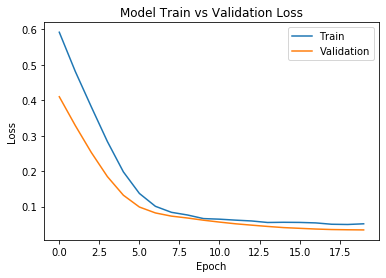

Train Score: 26434.94 RMSE
Test Score: 23073.26 RMSE


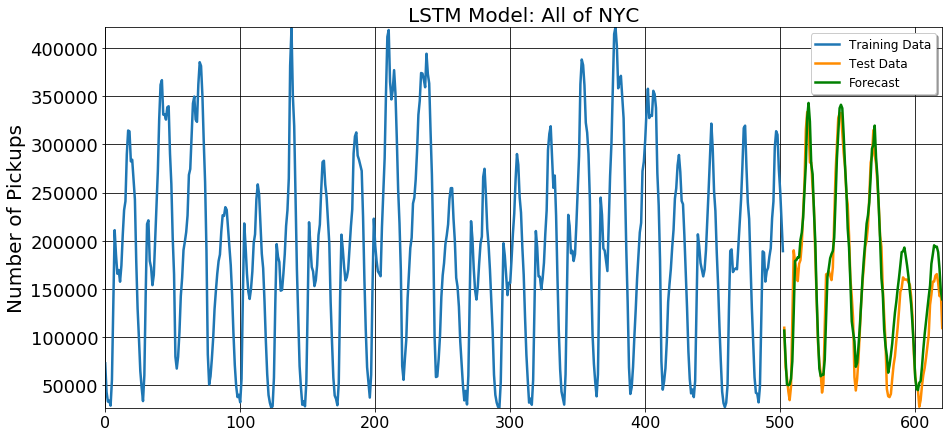

Location: All of NYC
Test MAE: 18495.228
Test RMSE: 23073.255
Test MAPE: 0.184
Test R²: 0.925


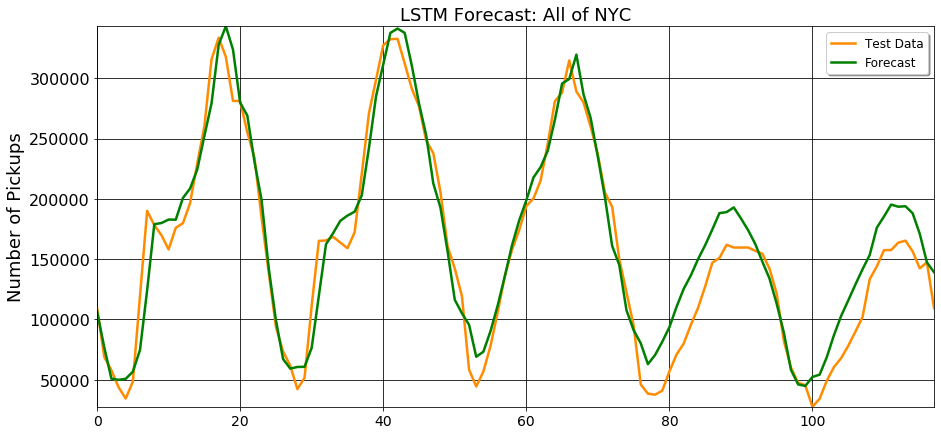

In [52]:
LSTM_Stats_All = lstmPlot(data=df_hourly, Location='All of NYC', SplitDate='2016-12-21 23:00:00',  
          features=['Hourly_Demand','sin_hour','cos_hour','sin_day','cos_day'], 
              layers=60, epochs=20, batch_size=20)

# LSTM Model Results - Bronx 

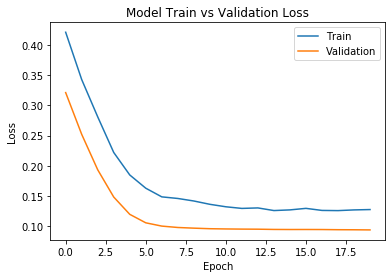

Train Score: 2912.85 RMSE
Test Score: 3135.84 RMSE


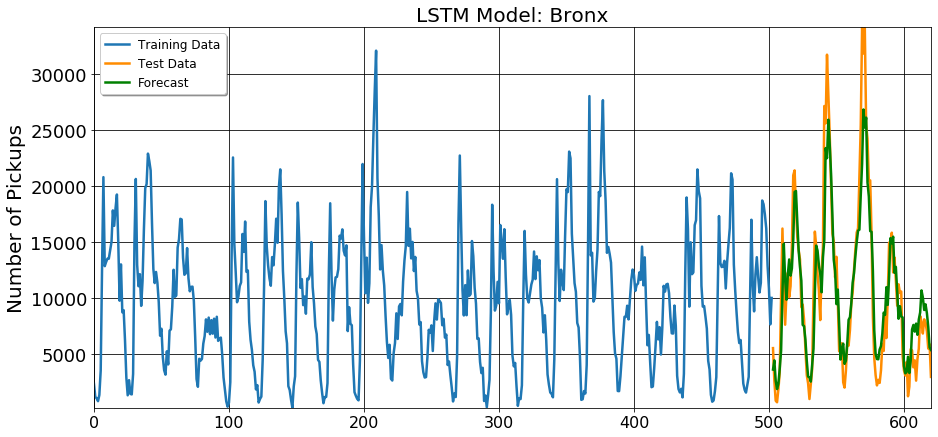

Location: Bronx
Test MAE: 2269.419
Test RMSE: 3135.839
Test MAPE: 0.361
Test R²: 0.835


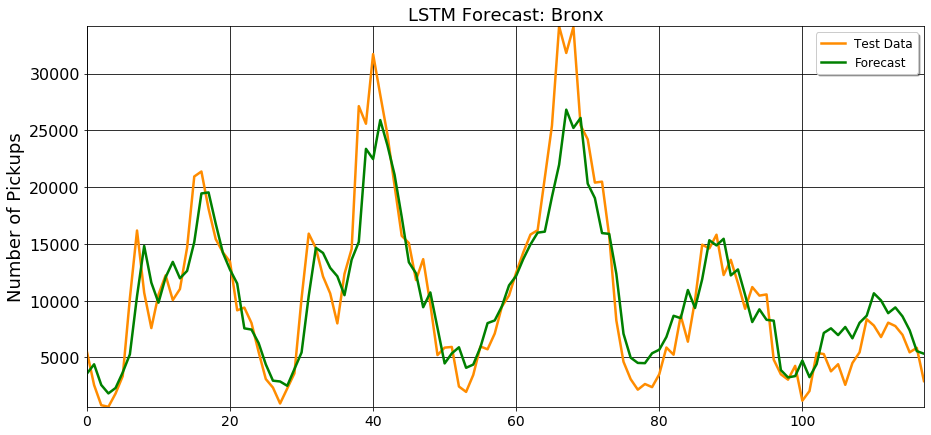

In [53]:
LSTM_Stats_Bronx = lstmTaxi = lstmPlot(data=data_hourly['Bronx'], Location='Bronx', SplitDate='2016-12-21 23:00:00',  
                    features=['Hourly_Demand','sin_hour','cos_hour','sin_day','cos_day'], 
                        layers=60, epochs=20, batch_size=20)

# LSTM Model Results - Brooklyn

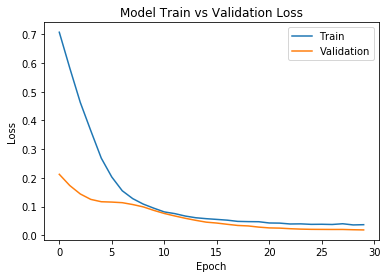

Train Score: 11060.92 RMSE
Test Score: 9681.84 RMSE


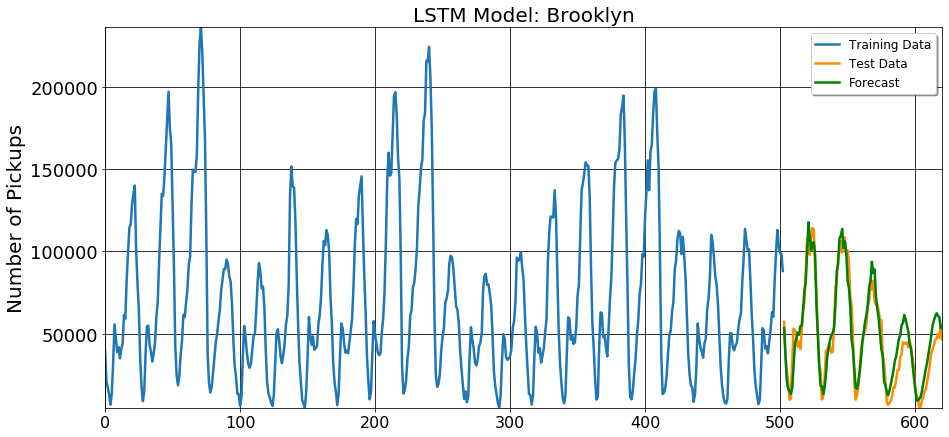

Location: Brooklyn
Test MAE: 8118.333
Test RMSE: 9681.841
Test MAPE: 0.272
Test R²: 0.891


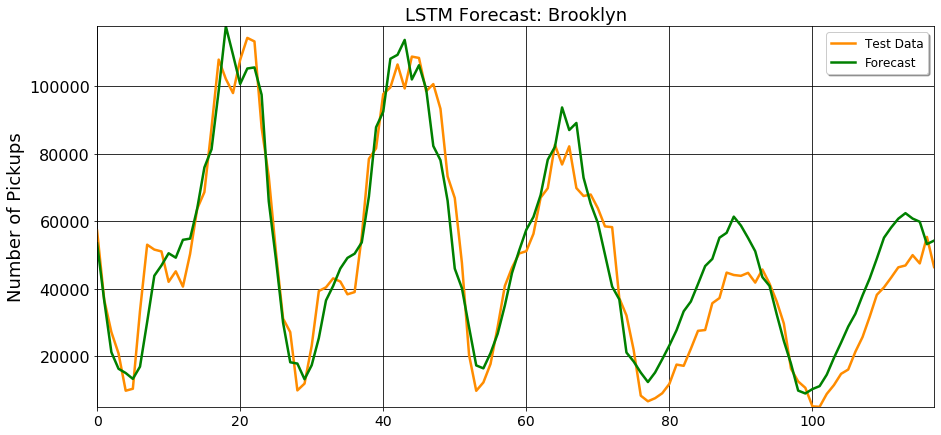

In [54]:
LSTM_Stats_Brooklyn = lstmPlot(data=data_hourly['Brooklyn'], Location='Brooklyn', SplitDate='2016-12-21 23:00:00',  
         features=['Hourly_Demand','sin_hour','cos_hour','sin_day','cos_day'], 
             layers=60, epochs=30, batch_size=20)

# LSTM Model Results - Manhattan

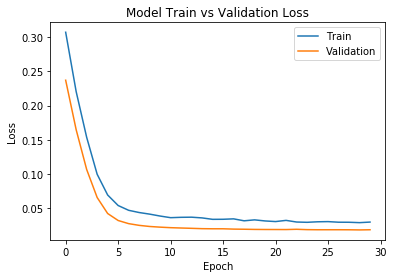

Train Score: 8412.63 RMSE
Test Score: 7910.58 RMSE


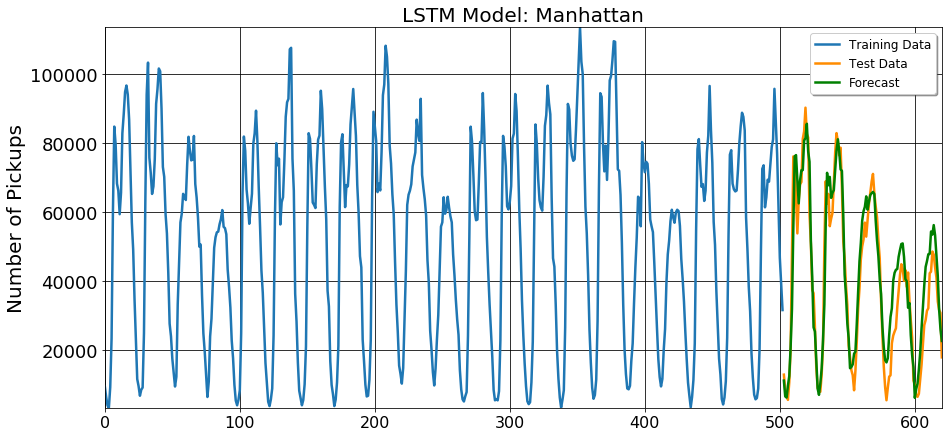

Location: Manhattan
Test MAE: 6322.547
Test RMSE: 7910.581
Test MAPE: 0.251
Test R²: 0.883


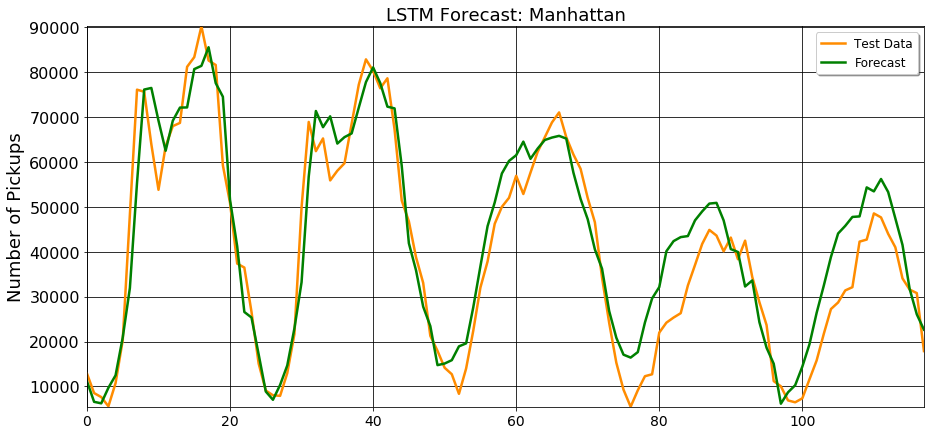

In [55]:
LSTM_Stats_Manhattan = lstmPlot(data=data_hourly['Manhattan'], Location='Manhattan', SplitDate='2016-12-21 23:00:00',  
         features=['Hourly_Demand','sin_hour','cos_hour','sin_day','cos_day'], 
             layers=60, epochs=30, batch_size=20)

# LSTM Model Results - Queens

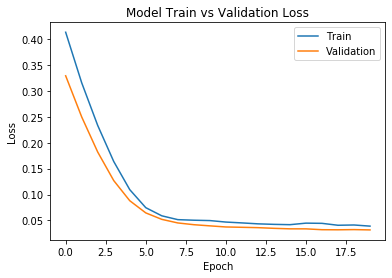

Train Score: 8587.57 RMSE
Test Score: 7705.03 RMSE


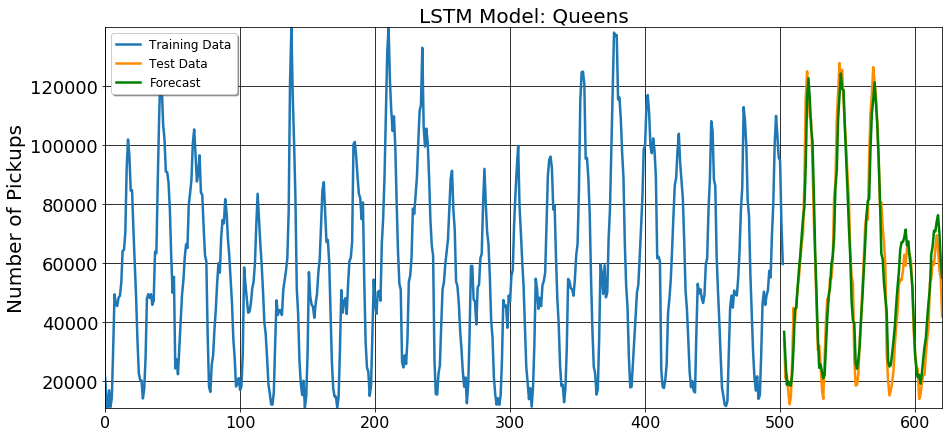

Location: Queens
Test MAE: 6346.755
Test RMSE: 7705.033
Test MAPE: 0.154
Test R²: 0.943


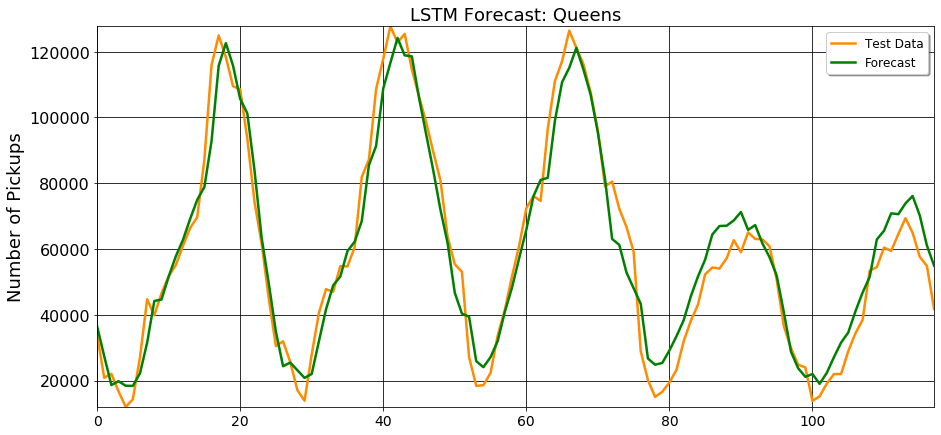

In [56]:
LSTM_Stats_Queens = lstmPlot(data=data_hourly['Queens'], Location='Queens', SplitDate='2016-12-21 23:00:00',  
         features=['Hourly_Demand','sin_hour','cos_hour','sin_day','cos_day'], 
                layers=60, epochs=20, batch_size=20)

In [57]:
Arima_stats = [Arima_Stats_All, Arima_Stats_Bronx, Arima_Stats_Brooklyn, Arima_Stats_Manhattan, Arima_Stats_Queens]
Prophet_stats = [Prophet_Stats_All, Prophet_Stats_Bronx, Prophet_Stats_Brooklyn, Prophet_Stats_Manhattan, Prophet_Stats_Queens]
LSTM_stats = [LSTM_Stats_All, LSTM_Stats_Bronx, LSTM_Stats_Brooklyn, LSTM_Stats_Manhattan, LSTM_Stats_Queens]

column_labels = ['All of NYC','Bronx','Brooklyn','Manhattan','Queens']
index_labels = ['MAE','RMSE','MAPE','R\u00B2']

Arima_df = pd.DataFrame(Arima_stats)
Arima_df = Arima_df.T
Arima_df.columns = column_labels
Arima_df.index = index_labels

Prophet_df = pd.DataFrame(Prophet_stats)
Prophet_df = Prophet_df.T
Prophet_df.columns = column_labels
Prophet_df.index = index_labels

LSTM_df = pd.DataFrame(LSTM_stats)
LSTM_df = LSTM_df.T
LSTM_df.columns = column_labels
LSTM_df.index = index_labels

# Final Modeling Results

Below is a collection of metrics summarizing the performance for each model in separate tables. The columns denote each model by location and the rows are each particular metric that was used to quantify the output. Each mode; was trained on the first three weeks of the month (DEC 1st - DEC 21st). Forecasts were made on the fourth week of the month (DEC 22nd - DEC 26th). As mentioned earlier, (DEC 27th - DEC 31st) was not included in the original Taxi Trips DataFrame. 

In [58]:
print("\033[1m" + 'ARIMA Model Table:'+ "\033[0m")
Arima_df

ARIMA Model Table:


,All of NYC,Bronx,Brooklyn,Manhattan,Queens
MAE,6325.088941,424.535700,3517.332640,1667.299561,1857.573944
RMSE,8322.404499,506.891498,4487.004899,2143.395421,2409.945346
MAPE,0.053795,0.046891,0.112929,0.064066,0.039988
R²,0.990128,0.995628,0.976856,0.991338,0.994398


The Seasonal ARIMA model is a univariate model that serves as a means to make baseline predictions for time series forecast. The ARIMA is a simpler model than the LSTM and can be used if the data exhibits a linear relationship. Across all metrics, the Seasonal ARIMA model has the best performance across all locations. In general, Mean Absolute Percent Error (MAPE) is a useful measure of forecast accuracy and serves as a very intuitive interpretation in terms of relative error. This metric is defined as the absolute difference between the actual and forecasted point divided by the actual point. The sum of every absolute value ratio is taken and then divided by the number of fitted points to return the mean. Considering that MAE is 5% or less than the average demand for each dataset, is a good sign that the MAE isn't egregious when the order of magnitude for the outputs is taken into account for each dataset. The Brooklyn model lacks slightly relative to the other models with a MAPE of 10.9%. The Brooklyn dataset contained noise and irregular influences over time; hence the jaggedness around the demand curves. As a result this pattern was harder for the model to learn despite the seasonal differencing. Overall this model performed well.

In [59]:
print("\033[1m" + 'FbProphet Model Table:' + "\033[0m")
Prophet_df

FbProphet Model Table:


,All of NYC,Bronx,Brooklyn,Manhattan,Queens
MAE,55484.277594,4394.704648,34352.671733,15938.190274,13564.218944
RMSE,68130.051943,6303.900058,42847.954964,19700.660485,17334.751197
MAPE,0.534975,0.634381,1.108581,0.574629,0.368173
R²,0.339494,0.329522,-1.143169,0.273007,0.710821


Like the ARIMA model, the FbProphet model is a univariate model that seeks to find a weekly and daily trend. Relative to the earlier observations, the Prophet model does an adequate job at identifying the peak demand times which manifested near 8AM/9AM and 7PM/8PM respectively. Obviously this observation will vary with a degree of tolerance depending on the location but the general pattern was captured by the model. Where the forecast likely failed however was in the weekly trend assessment. Recall when we looked at the Hourly Demand of the entire city by week; the weekly trend on the fourth week did not reflect that of the previous three weeks due to the influence of the holiday. Looking at any one of the Prophet outputs, the model mimicked the weekly trend it was trained on. The total amount of rides was also far less in the fourth week then the rest of the month. Expectedly, the forecast would not reflect the drop in the last week since the training data would have no indication of that. If we had access to the rest of the fourth week we might be seeing a different result but not likely. The metrics in this table suggest this model was the worst performing of the three. None of the five models performed to any moderate standard despite learning certain aspects of the data.    

In [60]:
print("\033[1m" + 'LSTM Model Table:' + "\033[0m")
LSTM_df

LSTM Model Table:


,All of NYC,Bronx,Brooklyn,Manhattan,Queens
MAE,18495.228151,2269.418647,8118.333107,6322.547471,6346.754949
RMSE,23073.255159,3135.838876,9681.841489,7910.581379,7705.033067
MAPE,0.183807,0.360593,0.272437,0.250832,0.154138
R²,0.924862,0.834612,0.890793,0.883076,0.943254


Finally we have the LSTM model. Unlike the two models above this algorithm considered other features in addition to the hourly demand time series; namely the sin and cos of the hour and day. This is advantageous because other inherent complexities can be captured within the daily trend. In general a LSTM is used over a traditional RNN because it is better at learning long range dependencies. The metrics suggest the performance across all locations was fair to moderate. The model appeared to perform the best on the entire city model and the Borough of Queens. Taking a second look at the plots for these datasets reveals that the shapes of these demand profiles are quite similar. The Bronx was the most challenging location to model and suffered greatly in terms of MAPE. Upon observing the data for that location, we see the data suffers similar noise and irregular influences over time like the Brooklyn dataset. Understanding that the LSTM trades off the cost of increased model complexity for superior performance, there are still improvements that can be made. Changing the network architecture and introducing other forms of encoding to important features are some of the ways to which we can improve the model as an LSTM has the ability to introduce extra features. These concepts would be applied to future work on this project along with the exploration of additional neural networks and CNNs. 